## Project: 
- **Goal**: Build an Image segmentation model that is able to segment images of clothes and segment them into seperate clothing items.
- **Deliverables**: A fine tuned models that receives multiple images and returns multiple segmented images in Json format.
- **Result**: Enhanced model with multi-image input(Enabled Bulk Upload), faster inference(from 6s for inference time to less than 100ms ), and 46% accuracy

## Dataset

**Dataset Structure:**

- Each row represents a **segment** within an image.
- More rows than unique images due to multiple segments per image.

**Key Columns:**

- **ImageId:** Unique image identifier
- **EncodedPixels:** Run Length Encoded segmentation mask
- **Height:** Image height
- **Width:** Image width
- **ClassId:** Segment class(ex: 1->pants, 2->jacket....)
- **AttributesIds:** (Optional) Additional attributes

**Example Row:**

| ImageId                                 | EncodedPixels  | Height  | Width  | ClassId  | AttributesIds |
|---|---|---|---|---|---|
| 000000663ed1ff0c4e0132b9b9ac53f6e6068157  | 7 6073371 20 6078584 34 6083797 48 608...521436766115,136,143,154,230,295,316,317  | 100000663ed1ff0c4e0132b9b9ac53f6e6323163  | 11 6328356 32 6333549 53 6338742 75 63...521436760115,136,142,146,225,295,316,317  | 200000663ed1ff0c4e0132b9b9ac53f6e8521389  | 10 8526585 30 8531789 42 8537002 46 85...5214367628163300000663ed1ff0c4e0132b9b9ac53f6e12903854  | 2 12909064 7 12914275 10 12919485 15 ...5214367631160,204400000663ed1ff0c4e0132b9b9ac53f6e10837337  | 5 10842542 14 10847746 24 10852951 33...5214367632219 |

**Run-Length Encoding (RLE):**

- `EncodedPixels` stores masks in RLE format in order to save space since binary masks take more storage.
- Example: `7 6073371 20 6078584 ...` indicates a run starting at pixel 7 with length 6073371, followed by another run.


In [1]:
# Import Libraries 

# General Libraries
import json  
import random  
import gc 
import shutil  
import os 

# Machine Learning / Deep Learning Libraries
import torch  
from ultralytics import YOLO 

# Computer Vision 
import cv2  
from imantics import Mask  
# Data Manipulation 
import pandas as pd  
import numpy as np  

# Data Splitting 
from sklearn.model_selection import train_test_split  

# Visualization Libraries
import matplotlib.pyplot as plt  
import matplotlib.image as mpimg  
import seaborn as sns  


# EDA

## Importing the data


In [2]:
# load data
dataset = pd.read_csv(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train.csv')
dataset.head()

,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,6,"115,136,143,154,230,295,316,317"
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,0,"115,136,142,146,225,295,316,317"
2,00000663ed1ff0c4e0132b9b9ac53f6e,8521389 10 8526585 30 8531789 42 8537002 46 85...,5214,3676,28,163
3,00000663ed1ff0c4e0132b9b9ac53f6e,12903854 2 12909064 7 12914275 10 12919485 15 ...,5214,3676,31,"160,204"
4,00000663ed1ff0c4e0132b9b9ac53f6e,10837337 5 10842542 14 10847746 24 10852951 33...,5214,3676,32,219


In [3]:
# load label descriptions
with open(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\label_descriptions.json', 'r') as file:
    label_description = json.load(file)

label_description

{'categories': [{'id': 0,
   'name': 'shirt, blouse',
   'supercategory': 'upperbody',
   'level': 2},
  {'id': 1,
   'name': 'top, t-shirt, sweatshirt',
   'supercategory': 'upperbody',
   'level': 2},
  {'id': 2, 'name': 'sweater', 'supercategory': 'upperbody', 'level': 2},
  {'id': 3, 'name': 'cardigan', 'supercategory': 'upperbody', 'level': 2},
  {'id': 4, 'name': 'jacket', 'supercategory': 'upperbody', 'level': 2},
  {'id': 5, 'name': 'vest', 'supercategory': 'upperbody', 'level': 2},
  {'id': 6, 'name': 'pants', 'supercategory': 'lowerbody', 'level': 2},
  {'id': 7, 'name': 'shorts', 'supercategory': 'lowerbody', 'level': 2},
  {'id': 8, 'name': 'skirt', 'supercategory': 'lowerbody', 'level': 2},
  {'id': 9, 'name': 'coat', 'supercategory': 'wholebody', 'level': 2},
  {'id': 10, 'name': 'dress', 'supercategory': 'wholebody', 'level': 2},
  {'id': 11, 'name': 'jumpsuit', 'supercategory': 'wholebody', 'level': 2},
  {'id': 12, 'name': 'cape', 'supercategory': 'wholebody', 'level':

In [77]:
# shape of our data
print(f'Shape of training dataset: {dataset.shape}')

Shape of training dataset: (333401, 6)


In [78]:
# Number of images we have 
print(f'Number of images in training dataset {dataset['ImageId'].nunique()}')

Number of images in training dataset 45623


In [ ]:
# check for duplicates
dataset.duplicated().sum()

In [ ]:
# check for null values
dataset.isna().sum()

## Image Shape

In [5]:
# Image size Analysis
pd.DataFrame([dataset['Height'].describe(), dataset['Width'].describe()]).T.loc[['min','max','mean','50%']].rename(index={'50%':'median'})

,Height,Width
min,296.000000,151.00000
max,8688.000000,10717.00000
mean,2235.524021,1761.97925
median,1600.000000,1200.00000


Text(0.5, 1.0, 'Width Distribution')

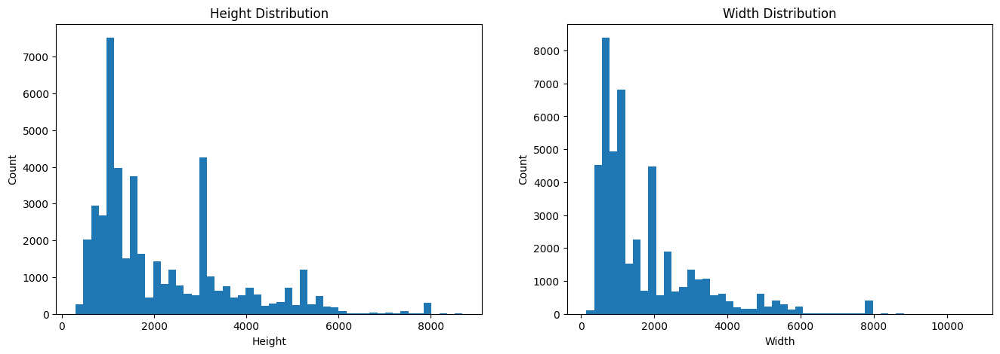

In [9]:
# Height and Width Distribution across images
image_shape_df = dataset.groupby("ImageId")[["Height", "Width"]].first()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))  

ax1.hist(image_shape_df['Height'], bins=50)
ax1.set_xlabel('Height')
ax1.set_ylabel('Count')
ax1.set_title('Height Distribution')

ax2.hist(image_shape_df['Width'], bins=50)
ax2.set_xlabel('Width')
ax2.set_ylabel('Count')
ax2.set_title('Width Distribution')

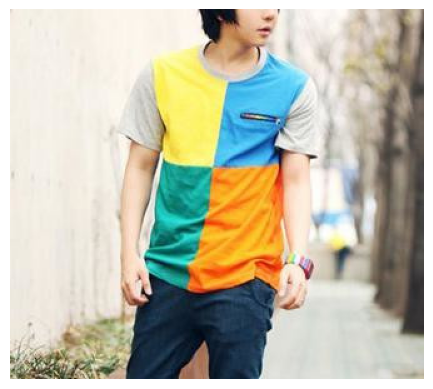

In [16]:
# Image with min height 
plt.figure()
min_height = list(set(dataset[dataset['Height'] == dataset['Height'].min()]['ImageId']))[0]
plt.imshow(mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{min_height}.jpg'))
plt.grid(False)
plt.axis('Off')
plt.show()

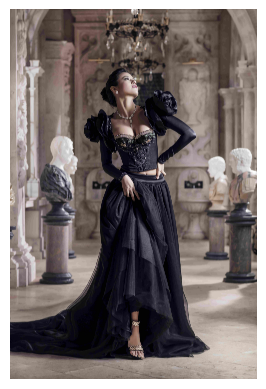

In [18]:
# Image with max height 
plt.figure()
max_height = list(set(dataset[dataset['Height'] == dataset['Height'].max()]['ImageId']))[0]
plt.imshow(mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{max_height}.jpg'))
plt.grid(False)
plt.axis('Off')
plt.show()

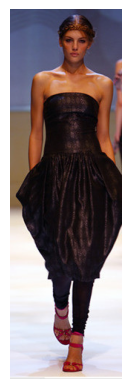

In [19]:
# Image with min width 
plt.figure()
min_width = list(set(dataset[dataset['Width'] == dataset['Width'].min()]['ImageId']))[0]
plt.imshow(mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{min_width}.jpg'))
plt.grid(False)
plt.axis(False)
plt.show()

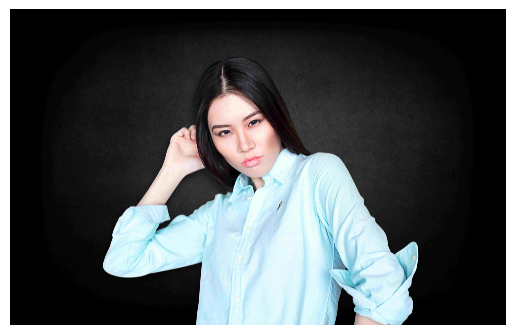

In [20]:
# Image with max width 
plt.figure()
max_width = list(set(dataset[dataset['Width'] == dataset['Width'].max()]['ImageId']))[0]
plt.imshow(mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{max_width}.jpg'))
plt.grid(False)
plt.axis(False)
plt.show()

In [21]:
# area df 
area_df = pd.DataFrame()
area_df['ImageId'] = dataset['ImageId']
area_df['area'] = dataset['Height'] * dataset['Width']

min_area = list(set(area_df[ area_df['area'] == area_df['area'].min()]['ImageId']))[0]
max_area = list(set(area_df[ area_df['area'] == area_df['area'].max()]['ImageId']))[0]
    

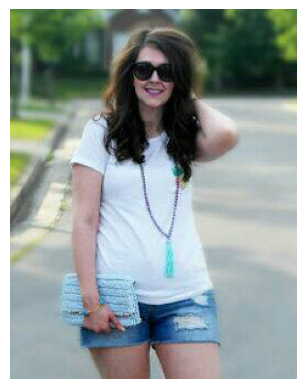

In [22]:
# Image with min area 
plt.figure()
plt.imshow(mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{min_area}.jpg'))
plt.axis(False)
plt.show()

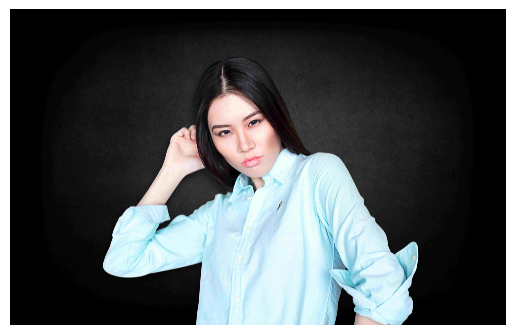

In [23]:
# Image with min area 
plt.figure()
plt.imshow(mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{max_area}.jpg'))
plt.axis(False)
plt.show()

## Analyze Categories 

In [4]:
# Details about classes and attributes 
num_classes = len(label_description['categories']) # determine nb of classes 
num_attributea = len(label_description['attributes']) # determine nb of attributes

print(f'total number of categories : {num_classes}')
print(f'total number of attributes : {num_attributea}')


total number of categories : 46
total number of attributes : 294


In [5]:
# transofrming categories json file to dataset to get a better understanding of the categoreis we have 
categories_df = pd.DataFrame(label_description['categories']) 
categories_df
16,17,22,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45

,id,name,supercategory,level
0,0,"shirt, blouse",upperbody,2
1,1,"top, t-shirt, sweatshirt",upperbody,2
2,2,sweater,upperbody,2
3,3,cardigan,upperbody,2
4,4,jacket,upperbody,2
5,5,vest,upperbody,2
6,6,pants,lowerbody,2
7,7,shorts,lowerbody,2
8,8,skirt,lowerbody,2
9,9,coat,wholebody,2


In [6]:
# transofrming attributes json file to dataset to get a better understanding of the categoreis we have 
attributes_df = pd.DataFrame(label_description['attributes'])
pd.set_option('display.max_rows',300) # to get full view of the df
attributes_df

,id,name,supercategory,level
0,0,classic (t-shirt),nickname,1
1,1,polo (shirt),nickname,1
2,2,undershirt,nickname,1
3,3,henley (shirt),nickname,1
4,4,ringer (t-shirt),nickname,1
...,...,...,...,...
289,336,peacock,animal,2
290,337,zebra,animal,2
291,338,giraffe,animal,2
292,339,toile de jouy,textile pattern,1


In [7]:
# adding how much each categories occur in our data
categories_occ = pd.DataFrame(dataset['ClassId'].value_counts())
categories_df = categories_df.merge(categories_occ, left_on= 'id',right_on='ClassId', how='left')
categories_df = categories_df.rename(columns={'count':'Nb of occurence'})
categories_df


,id,name,supercategory,level,Nb of occurence
0,0,"shirt, blouse",upperbody,2,6161
1,1,"top, t-shirt, sweatshirt",upperbody,2,16548
2,2,sweater,upperbody,2,1494
3,3,cardigan,upperbody,2,1107
4,4,jacket,upperbody,2,7833
5,5,vest,upperbody,2,719
6,6,pants,lowerbody,2,12414
7,7,shorts,lowerbody,2,2756
8,8,skirt,lowerbody,2,5046
9,9,coat,wholebody,2,3124


Now, it's time to plot categories distribution

C:\Users\sat\AppData\Local\Temp\ipykernel_11204\507038229.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = categories_df['Nb of occurence'], y= categories_df['name'], palette = 'copper')


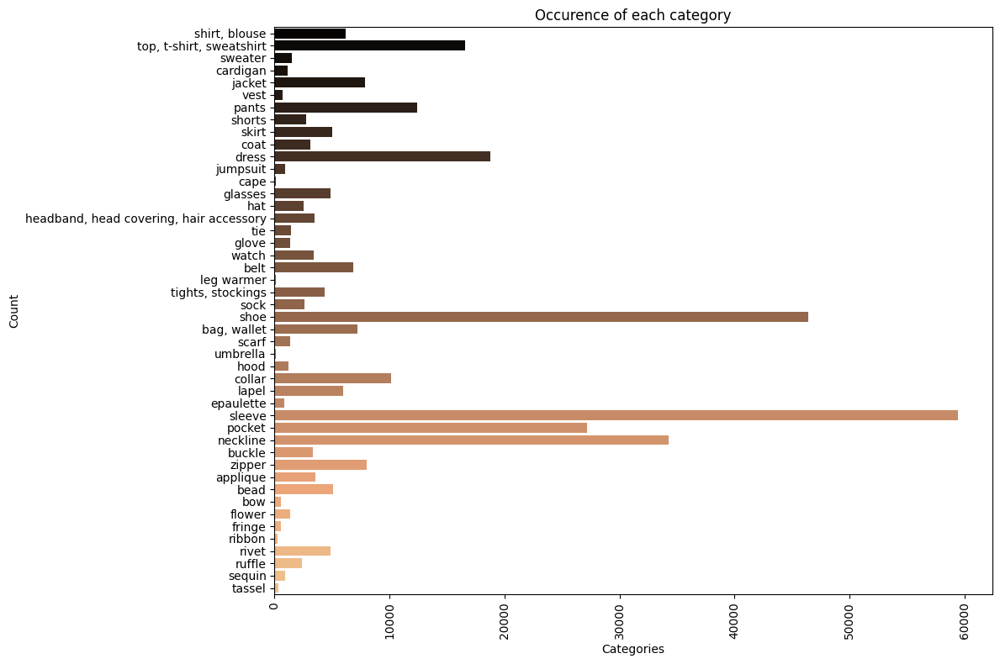

In [84]:
# create the bar plot 
plt.figure(figsize = (12,8))
sns.barplot(x = categories_df['Nb of occurence'], y= categories_df['name'], palette = 'copper')

# set labels and titles 
plt.xlabel('Categories')
plt.ylabel('Count')
plt.title("Occurence of each category")

# rotate x axis labels 
plt.xticks(rotation = 90, fontsize = 10)
plt.tight_layout()
plt.show()

In [29]:
# super category value count 
pd.set_option('display.max_rows', 50)
categories_df['supercategory'].value_counts()

supercategory
decorations       10
garment parts      7
upperbody          6
wholebody          4
legs and feet      4
lowerbody          3
head               3
others             3
arms and hands     2
closures           2
neck               1
waist              1
Name: count, dtype: int64

In [30]:
# level of categories 
categories_df['level'].value_counts()

level
2    46
Name: count, dtype: int64

In [31]:
# decoration categories 
categories_df[categories_df['supercategory'] == 'decorations']

,name,supercategory,level,Nb of occurence
id,,,,
36,applique,decorations,2,3529
37,bead,decorations,2,5084
38,bow,decorations,2,528
39,flower,decorations,2,1367
40,fringe,decorations,2,588
41,ribbon,decorations,2,274
42,rivet,decorations,2,4893
43,ruffle,decorations,2,2407
44,sequin,decorations,2,929


In [32]:
# upperbody categories 
categories_df[categories_df['supercategory'] == 'upperbody']

,name,supercategory,level,Nb of occurence
id,,,,
0,"shirt, blouse",upperbody,2,6161
1,"top, t-shirt, sweatshirt",upperbody,2,16548
2,sweater,upperbody,2,1494
3,cardigan,upperbody,2,1107
4,jacket,upperbody,2,7833
5,vest,upperbody,2,719


In [33]:
# lowerbody categories
categories_df[categories_df['supercategory'] == 'lowerbody']

,name,supercategory,level,Nb of occurence
id,,,,
6,pants,lowerbody,2,12414
7,shorts,lowerbody,2,2756
8,skirt,lowerbody,2,5046


In [34]:
# wholebody categories
categories_df[categories_df['supercategory'] == 'wholebody']

,name,supercategory,level,Nb of occurence
id,,,,
9,coat,wholebody,2,3124
10,dress,wholebody,2,18739
11,jumpsuit,wholebody,2,922
12,cape,wholebody,2,152


In [35]:
# garment parts categories
categories_df[categories_df['supercategory'] == 'garment parts']

,name,supercategory,level,Nb of occurence
id,,,,
27,hood,garment parts,2,1226
28,collar,garment parts,2,10159
29,lapel,garment parts,2,5972
30,epaulette,garment parts,2,874
31,sleeve,garment parts,2,59448
32,pocket,garment parts,2,27179
33,neckline,garment parts,2,34258


In [36]:
# leg and feet categories
categories_df[categories_df['supercategory'] == 'legs and feet']

,name,supercategory,level,Nb of occurence
id,,,,
20,leg warmer,legs and feet,2,112
21,"tights, stockings",legs and feet,2,4326
22,sock,legs and feet,2,2582
23,shoe,legs and feet,2,46374


In [37]:
# other categories
categories_df[categories_df['supercategory'] == 'others']

,name,supercategory,level,Nb of occurence
id,,,,
24,"bag, wallet",others,2,7217
25,scarf,others,2,1374
26,umbrella,others,2,135


In [38]:
# arms and hands categories
categories_df[categories_df['supercategory'] == 'arms and hands']

,name,supercategory,level,Nb of occurence
id,,,,
17,glove,arms and hands,2,1385
18,watch,arms and hands,2,3389


In [39]:
# closures categories
categories_df[categories_df['supercategory'] == 'closures']

,name,supercategory,level,Nb of occurence
id,,,,
34,buckle,closures,2,3300
35,zipper,closures,2,7991


In [40]:
# waist categories
categories_df[categories_df['supercategory'] == 'waist']

,name,supercategory,level,Nb of occurence
id,,,,
19,belt,waist,2,6851


In [41]:
# neck categories
categories_df[categories_df['supercategory'] == 'neck']

,name,supercategory,level,Nb of occurence
id,,,,
16,tie,neck,2,1457


## Displaying Samples

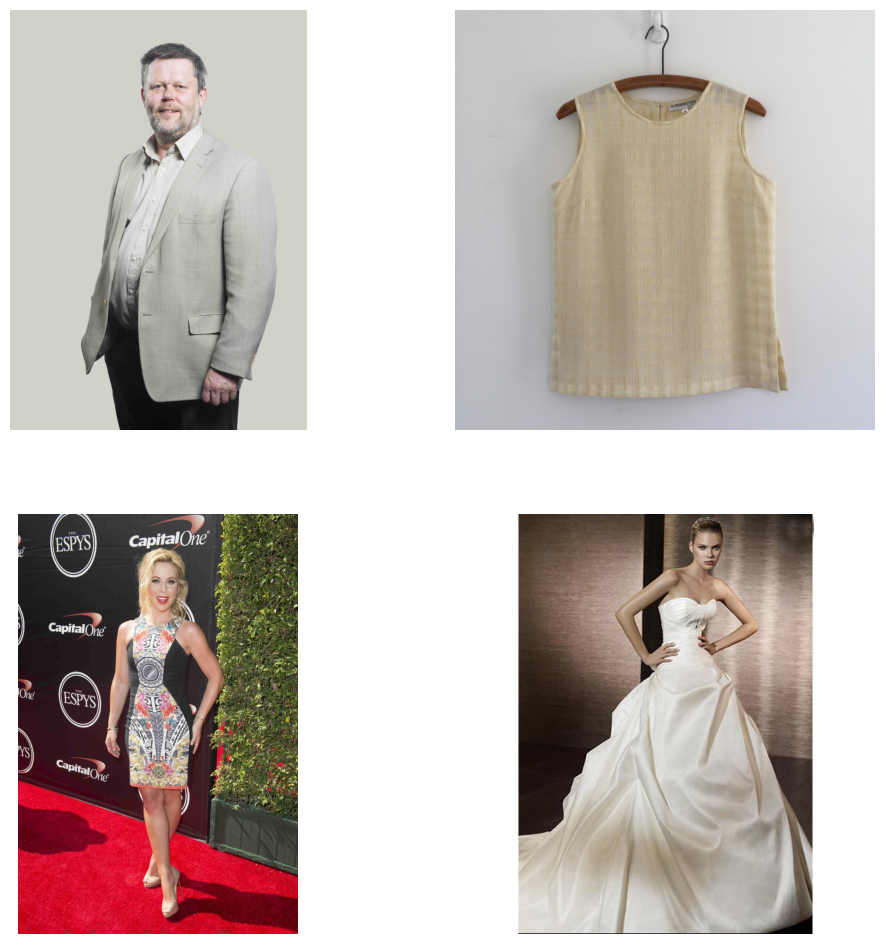

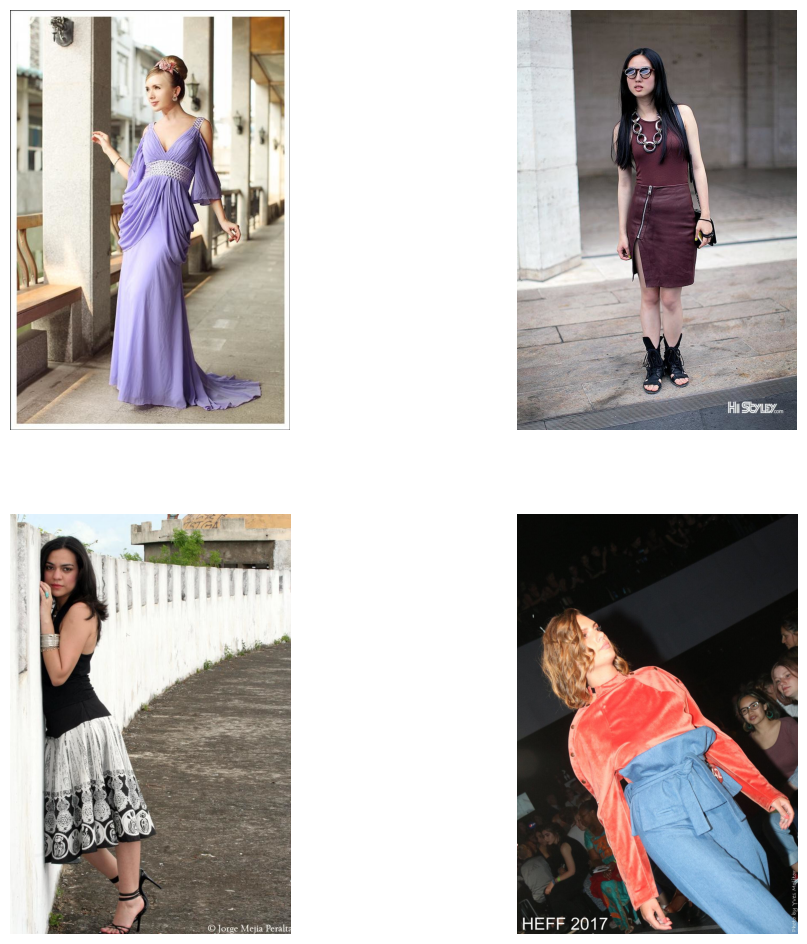

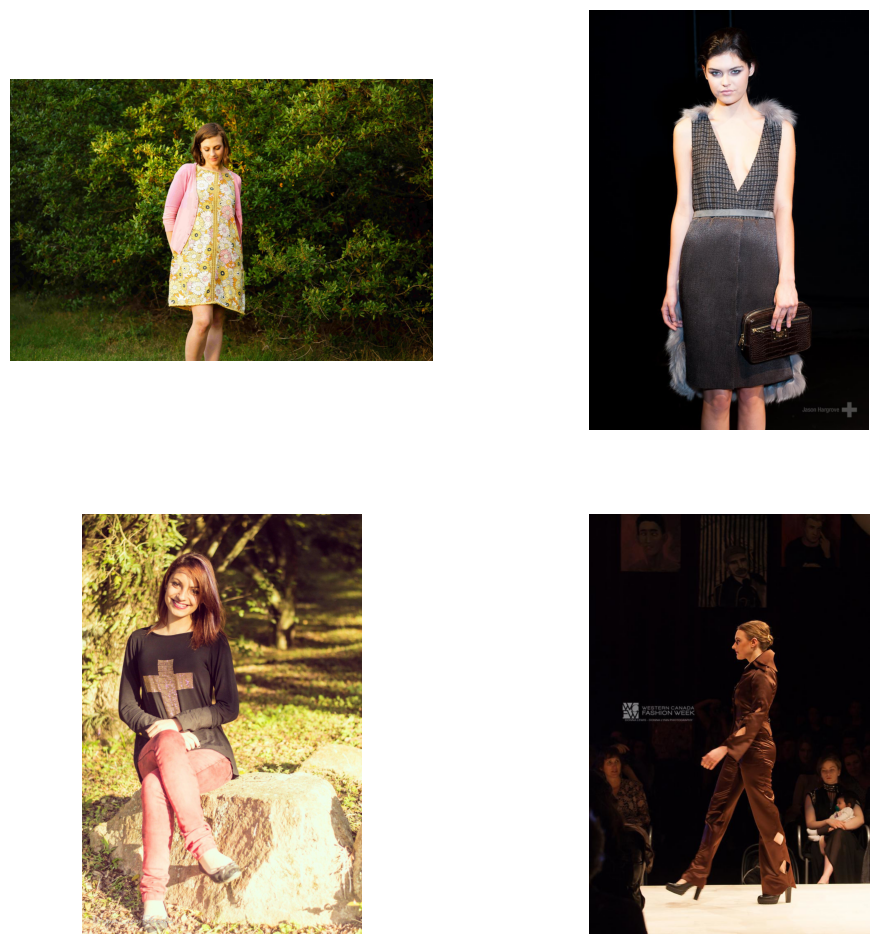

In [45]:
# exploring some picture from the dataset
def plot_sequence_img(size: int = 12, figsize: tuple = (12, 12)):
    """
    This function plots a sequence of images from a dataset in groups.

    Args:
        size: The total number of images
        figsize: The size of the figure in inches

    Returns:
        Plots of pictures
    """

    # first get some img ids 
    image_ids = dataset['ImageId'].unique()[:12]
    images = []

    for image in image_ids:
        img_path = fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{image}.jpg'
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        images.append(img)

    # plot img in groups of 4 
    n = 4

    count = 0
    for index in range(size//4):
        fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = figsize)
        for row in ax:
            for col in row:
                col.imshow(images[count])
                col.axis('off')
                count += 1 
        plt.show()
    # collect gc to free up memory 
    gc.collect()

# apply function
plot_sequence_img()

In [49]:
def create_mask(size: int) -> tuple[list[np.ndarray], list[dict]]:
    """
    Creates masks for a specified number of images in a dataset.

    Args:
        size (int): The number of images to process.

    Returns:
        tuple: A tuple containing:
            - masks (list): A list of binary masks for each image.
            - images_meta (list): A list of image metadata dictionaries.
    """

    image_ids = dataset['ImageId'].unique()[:size]
    images_meta = []

    for image_id in image_ids:
        # Load the image and store metadata
        img_path = fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{image_id}.jpg'
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB for plotting

        images_meta.append({
            'image': img,
            'shape': img.shape,
            'encoded_pixels': dataset[dataset['ImageId'] == image_id]['EncodedPixels'],
            'class_ids': dataset[dataset['ImageId'] == image_id]['ClassId']
        })

    masks = []
    for image_meta in images_meta:
        shape = image_meta['shape']
        encoded_pixels = image_meta['encoded_pixels']
        class_ids = image_meta['class_ids']

        # Initialize the mask array with zeros
        height, width = shape[:2]
        mask = np.zeros((height, width)).reshape(-1)

        # Iterate over encoded pixels and create the mask
        for segment, (pixel_str, class_id) in enumerate(zip(encoded_pixels, class_ids)):
            splitted_pixels = list(map(int, pixel_str.split()))
            pixel_starts = splitted_pixels[::2]
            run_lengths = splitted_pixels[1::2]

            # Ensure pixel starts are within the mask shape
            assert max(pixel_starts) < mask.shape[0]
            # encode RLE masks
            for pixel_start, run_length in zip(pixel_starts, run_lengths):
                pixel_start = int(pixel_start) - 1
                run_length = int(run_length)
                mask[pixel_start:pixel_start + run_length] = 255 - class_id * 4

        # Reshape the mask back to its original shape
        masks.append(mask.reshape((height, width), order='F'))

    return masks, images_meta

In [47]:
# show images with the corresponding mask segmentation
def plot_segmented_images(size=12, figsize=(14, 14)):
    """
    Plots a sequence of images with their corresponding segmentation masks.

    Args:
        size (int, optional): The number of image-mask pairs to plot. Defaults to 12.
        figsize (tuple, optional): The size of the figure in inches. Defaults to (14, 14).
    """
    # create masks for first (size nb) in dataset
    masks, images_meta = create_mask(size)
    
    # Plot images in groups of 4 images
    n_groups = 4
    
    count = 0
    for index in range(size // 4):
        fig, ax = plt.subplots(nrows=2, ncols=2, figsize=figsize)
        for row in ax:
            for col in row:
                col.imshow(images_meta[count]['image'])
                col.imshow(masks[count], alpha=0.75)
                col.axis('off')
                count += 1
        plt.show()
    gc.collect()

background in purple while segments in different colors

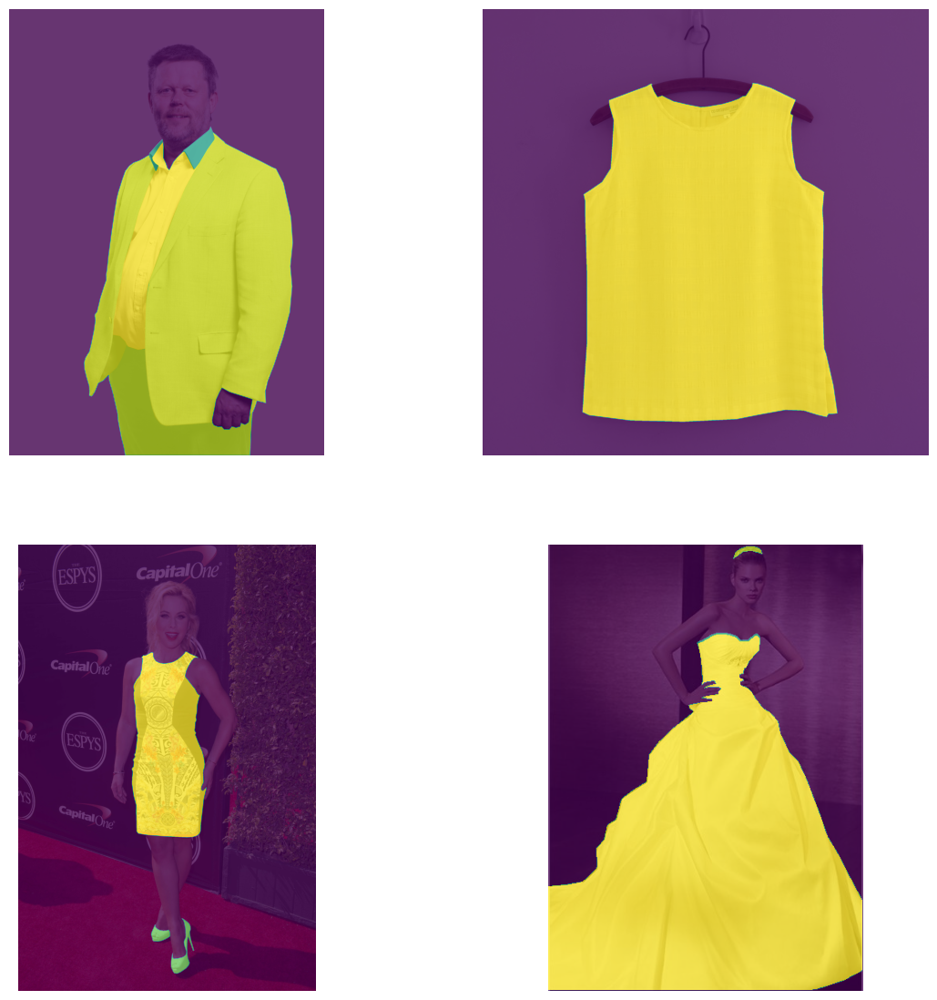

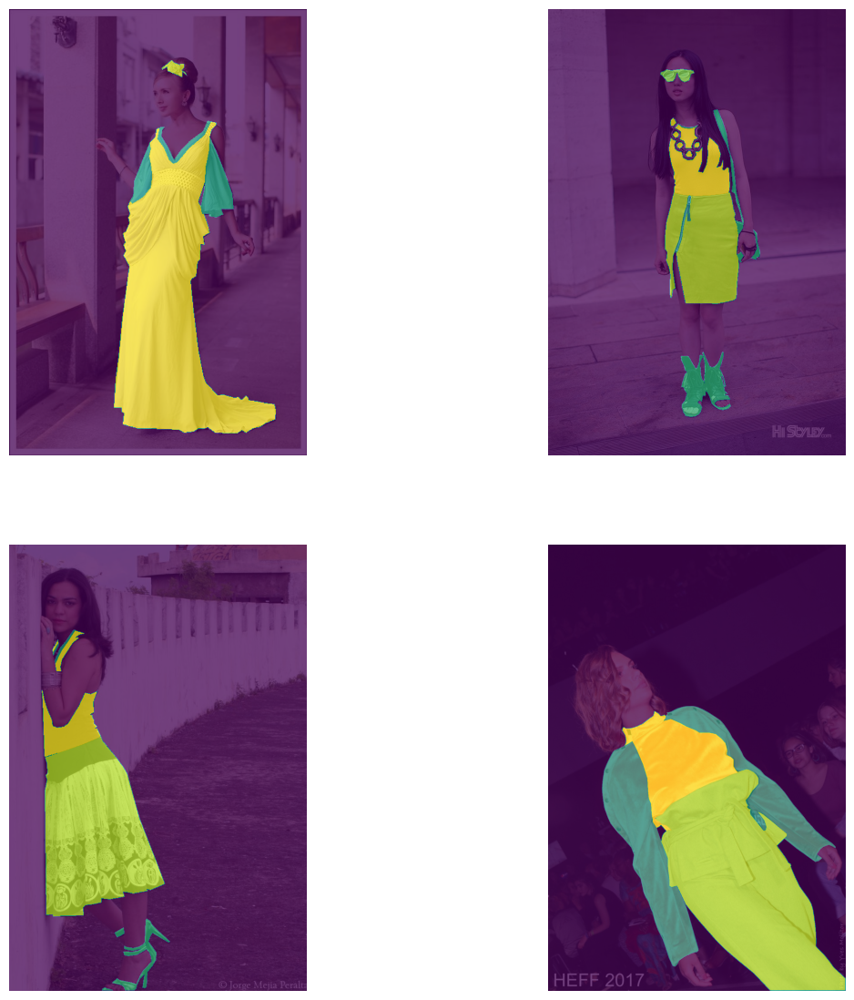

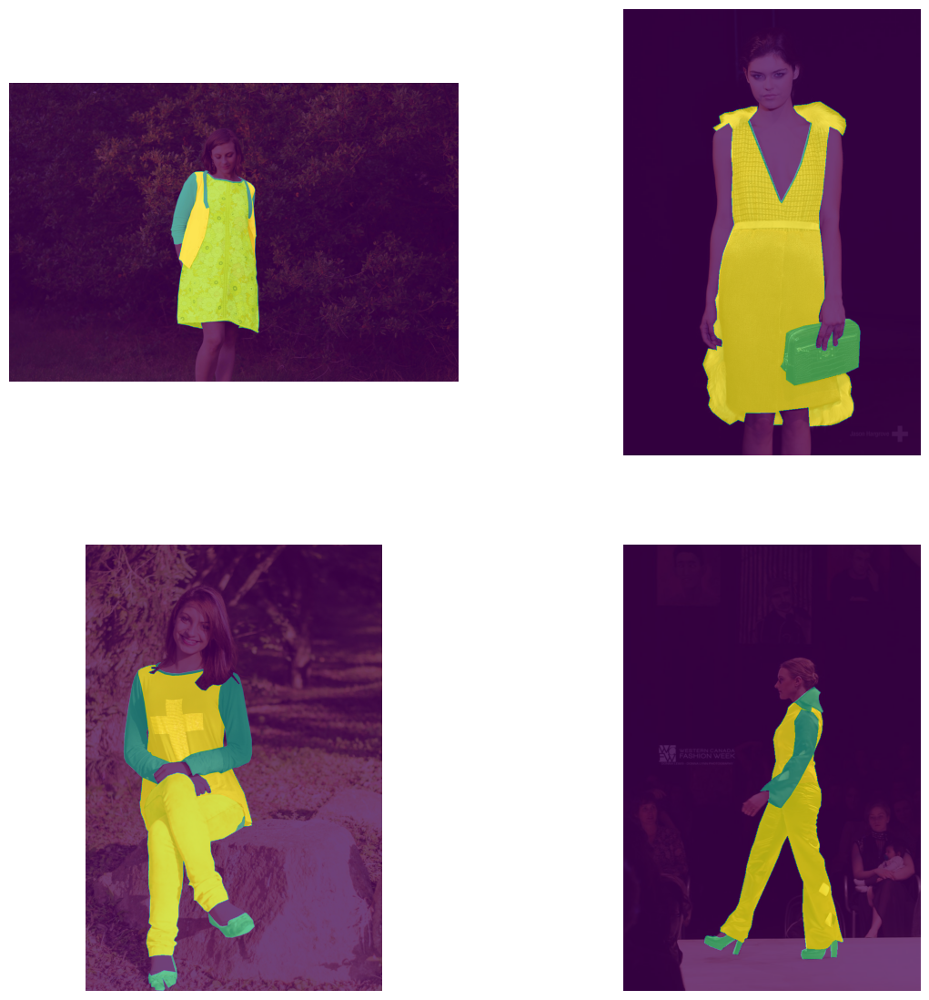

In [50]:
plot_segmented_images()


## Plot segments seperatly  

### first instance

[]

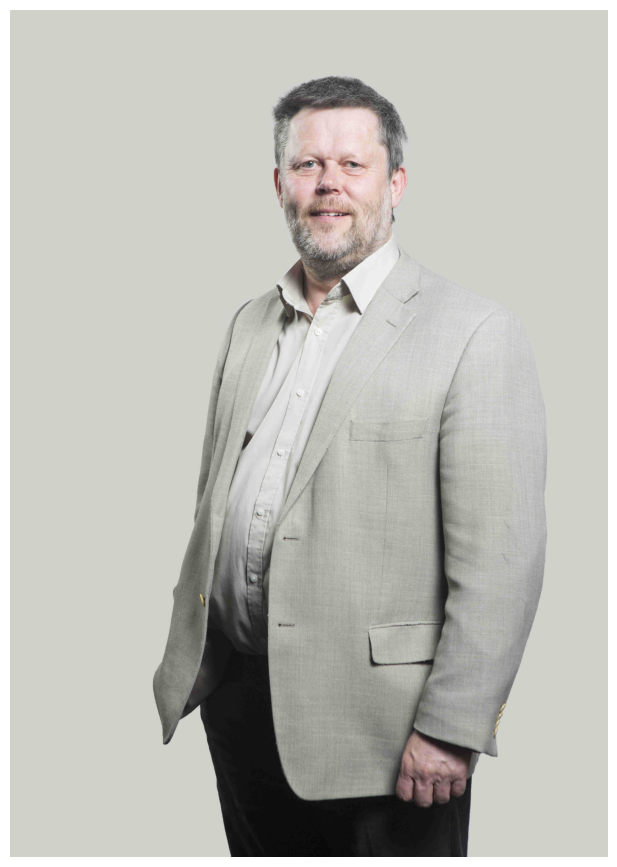

In [51]:
plt.figure(figsize=(110,11))
img_id = dataset.loc[0]['ImageId']

# reading insance 
image = mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{img_id}.jpg')

plt.grid(False)
plt.imshow(image)
plt.axis('off')
plt.plot()

In [52]:
# all segments in for the following image
segmentInstance = dataset[dataset['ImageId'] == img_id]
segmentInstance


,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,6,"115,136,143,154,230,295,316,317"
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,0,"115,136,142,146,225,295,316,317"
2,00000663ed1ff0c4e0132b9b9ac53f6e,8521389 10 8526585 30 8531789 42 8537002 46 85...,5214,3676,28,163
3,00000663ed1ff0c4e0132b9b9ac53f6e,12903854 2 12909064 7 12914275 10 12919485 15 ...,5214,3676,31,"160,204"
4,00000663ed1ff0c4e0132b9b9ac53f6e,10837337 5 10842542 14 10847746 24 10852951 33...,5214,3676,32,219
5,00000663ed1ff0c4e0132b9b9ac53f6e,11464158 10 11469372 30 11474586 43 11479800 4...,5214,3676,32,219
6,00000663ed1ff0c4e0132b9b9ac53f6e,5910568 31 5915775 65 5920982 69 5926189 73 59...,5214,3676,31,"160,204"
7,00000663ed1ff0c4e0132b9b9ac53f6e,6421446 292 6426657 298 6431867 305 6437078 31...,5214,3676,29,174
8,00000663ed1ff0c4e0132b9b9ac53f6e,4566382 8 4571592 25 4576803 41 4582013 58 458...,5214,3676,4,"17,115,136,145,149,225,295,311,317"


In [53]:
# decoding each segment into binary masks
segments = list(segmentInstance['EncodedPixels'])
class_ids = list(segmentInstance['ClassId'])
masks = []

for segment, class_id in zip(segments, class_ids):

    height = segmentInstance['Height'][0]
    width = segmentInstance['Width'][0]
    # Initialize empty mask
    mask = np.zeros((height, width)).reshape(-1)

    # iterate over encoded pixel and create mask 
    splitted_pixels = list(map(int, segment.split()))
    pixel_starts = splitted_pixels[::2]
    run_lengths = splitted_pixels[1::2]
    assert max(pixel_starts) < mask.shape[0]
    for pixel_start, run_length in zip(pixel_starts, run_lengths):
        pixel_start = int(pixel_start) - 1
        run_length = int(run_length)
        mask[pixel_start:pixel_start + run_length] = 255 - class_id * 4
    # store masks in list
    mask = mask.reshape((height, width), order = 'F')
    masks.append(mask)

In [54]:
def plot_individual_segment(*masks, image, figsize=(110,11)):
    """
    Plots an image with its seperate masks .

    Args:
        image (numpy.ndarray): The image array in RGB format.
        *masks (list[numpy.ndarray]): A list of binary mask arrays, one for each segment.
        figsize (tuple, optional): Size of the figure in inches. Defaults to (10, 10).
        title (str, optional): Title for the plot. Defaults to None.
    """
    plt.figure(figsize = figsize)
    plt.imshow(image)
    for mask in masks:
        plt.imshow(mask, alpha=0.5)
    plt.axis('off')
    plt.show()

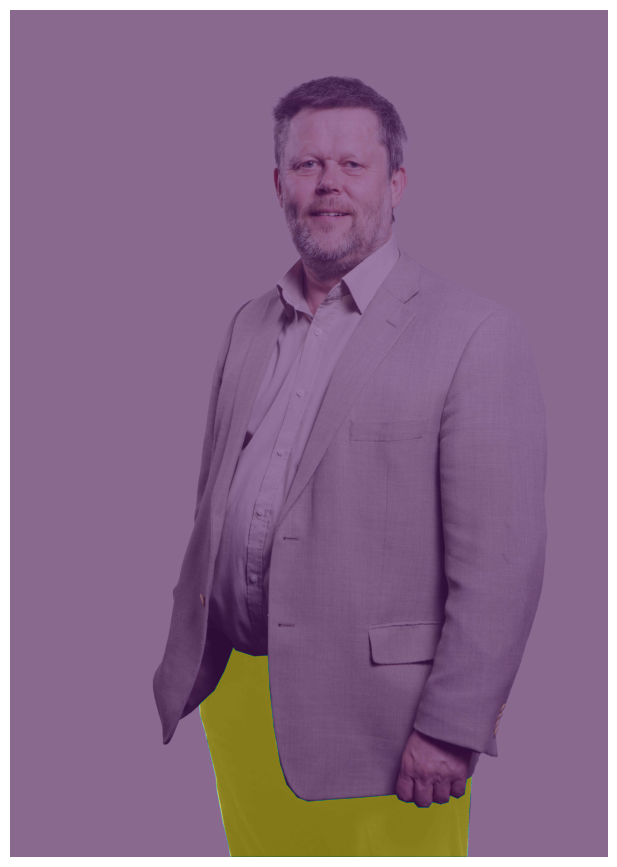

In [55]:
# Pants
plot_individual_segment(masks[0], image=image)


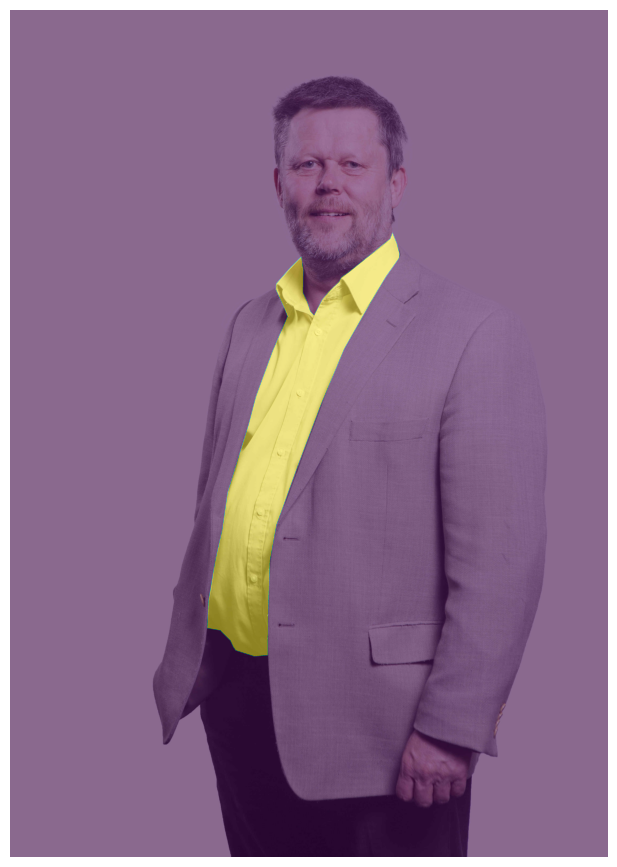

In [56]:
# Shirt or Blouse
plot_individual_segment(masks[1], image=image)


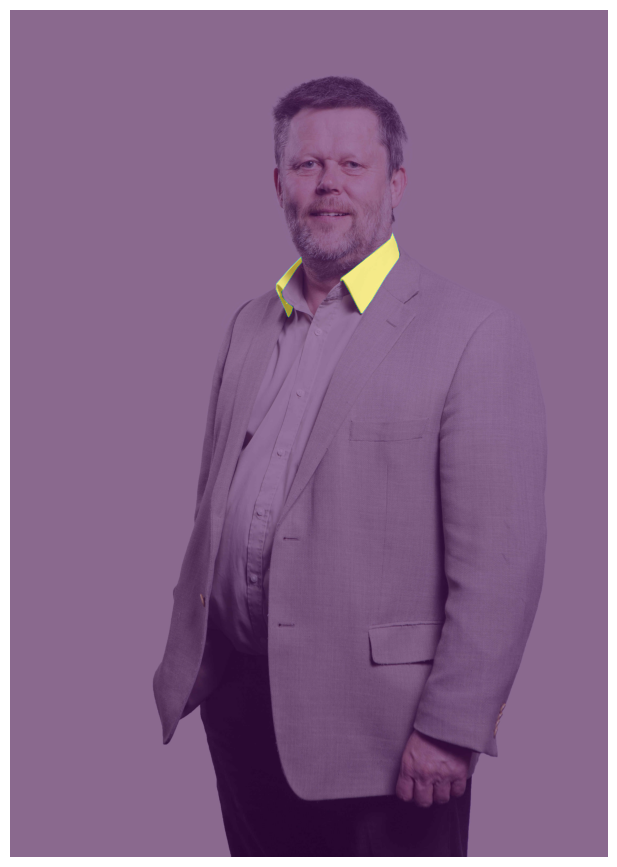

In [57]:
# Collar
plot_individual_segment(masks[2], image=image)


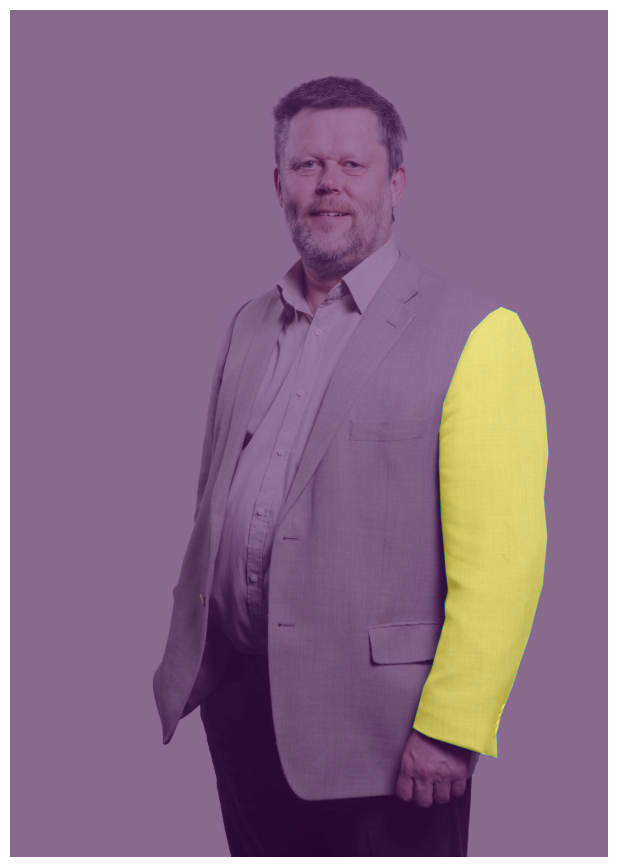

In [58]:
# Sleeve
plot_individual_segment(masks[3], image=image)


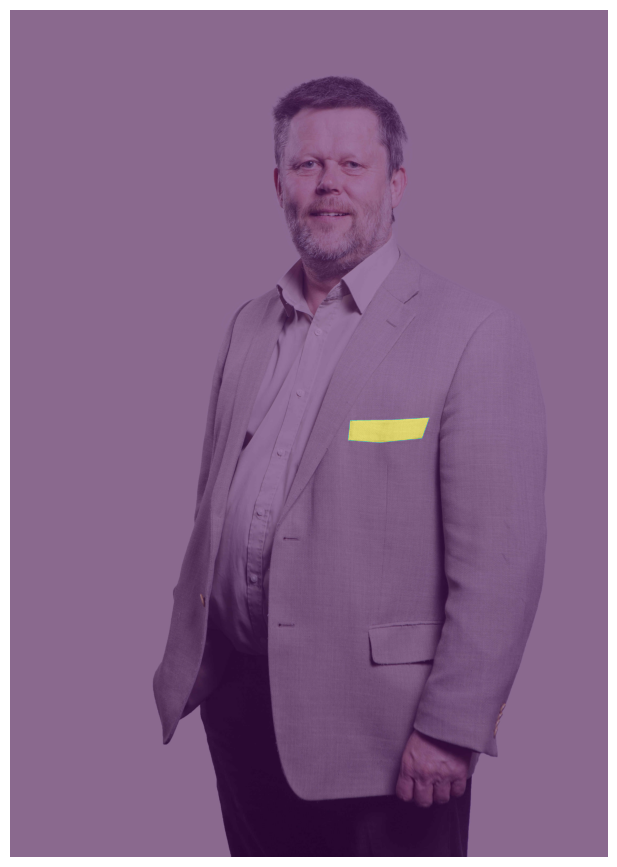

In [59]:
# Pocket
plot_individual_segment(masks[4], image=image)


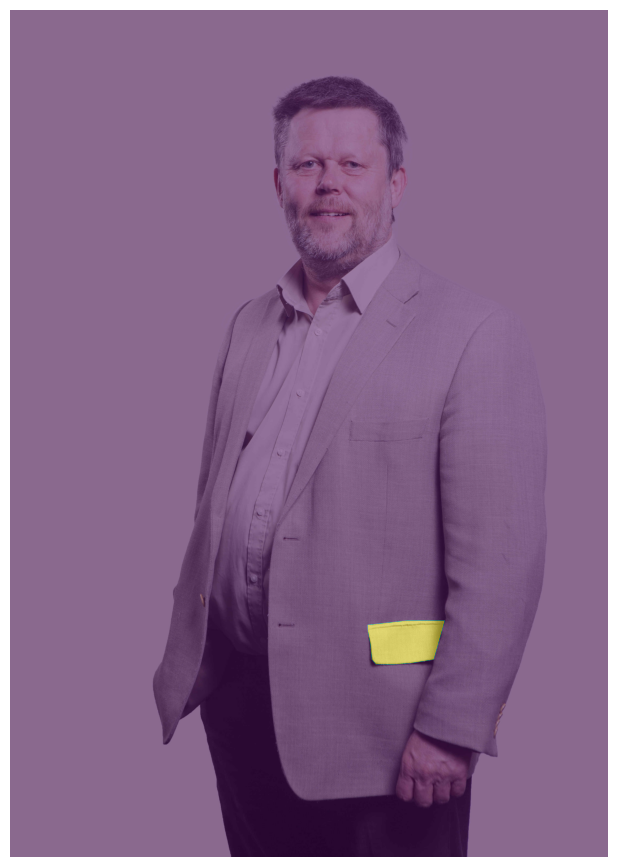

In [60]:
# Pocket
plot_individual_segment(masks[5], image=image)


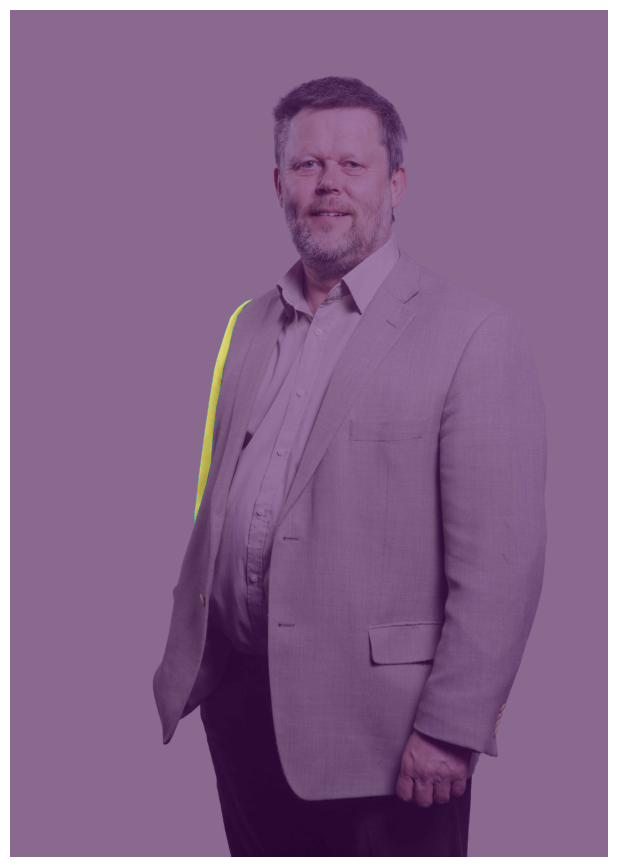

In [61]:
# Sleeve
plot_individual_segment(masks[6], image=image)


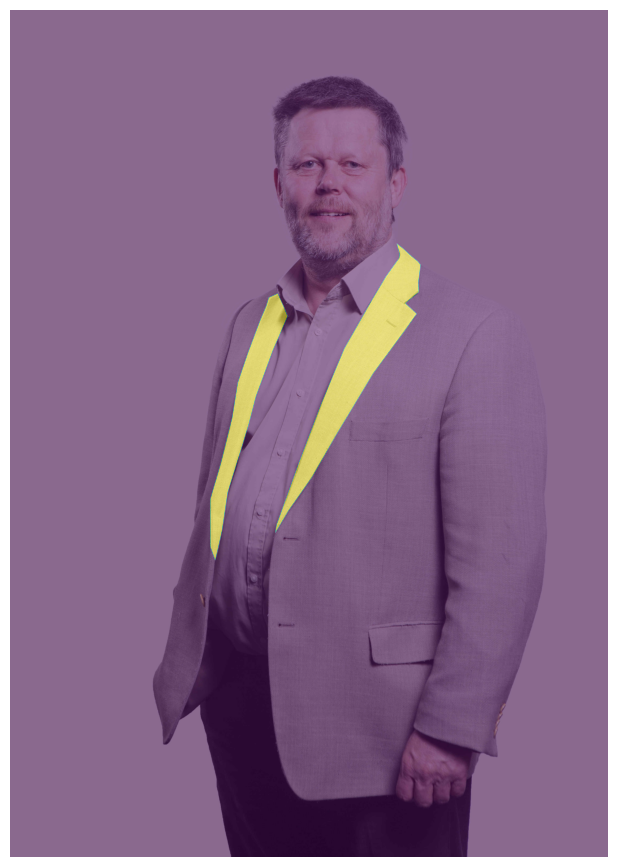

In [62]:
# lapel
plot_individual_segment(masks[7], image=image)


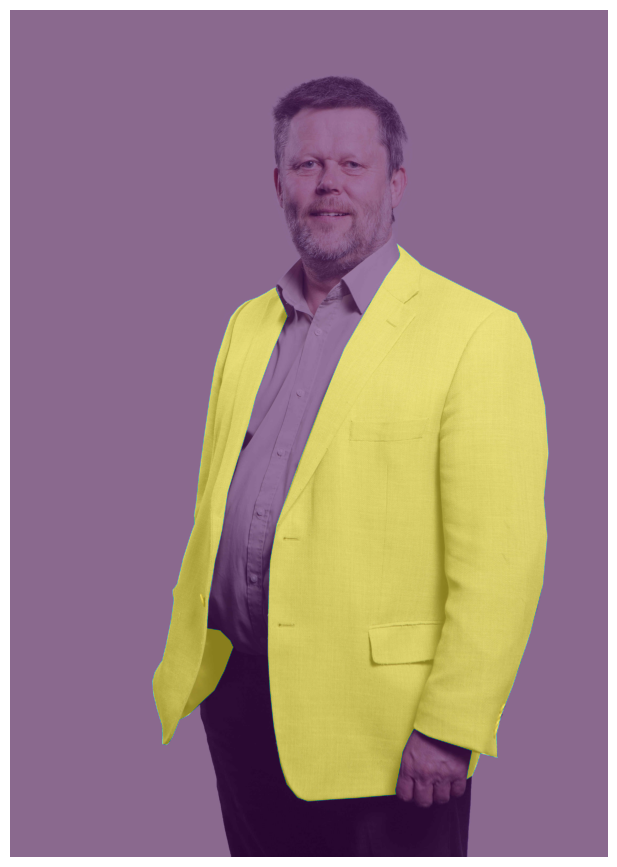

In [63]:
# jacket
plot_individual_segment(masks[8], image=image)


### second instance 

same as above but for different pic

[]

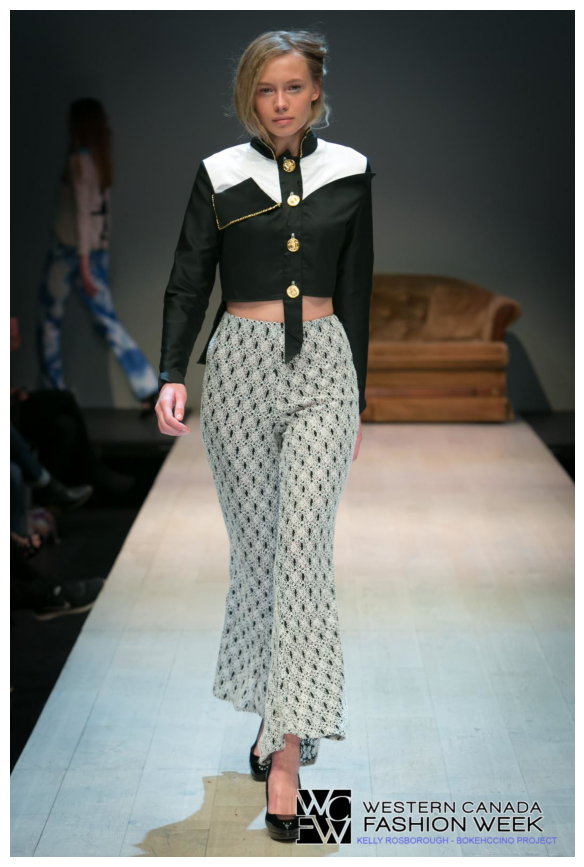

In [64]:
plt.figure(figsize=(110,11))
img_id = dataset.loc[24279]['ImageId']
image = mpimg.imread(fr'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train\{img_id}.jpg')
plt.grid(False)
plt.imshow(image)
plt.axis('off')
plt.plot()

In [65]:
# segments for the following image
segmentInstance1 = dataset[dataset['ImageId'] == img_id]
segmentInstance1


,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
24275,12bc95795fa9d6ac25ff7f1a65261ad6,443896 5 445495 15 447093 26 448692 30 450268 ...,1600,1067,4,"35,115,135,145,146,225,295,311,317"
24276,12bc95795fa9d6ac25ff7f1a65261ad6,725050 4 726648 9 728246 12 729844 15 731442 1...,1600,1067,28,167
24277,12bc95795fa9d6ac25ff7f1a65261ad6,973350 11 974940 29 976533 40 978126 48 979719...,1600,1067,31,"160,204"
24278,12bc95795fa9d6ac25ff7f1a65261ad6,443896 5 445494 16 447093 26 448669 7 448691 3...,1600,1067,31,"160,204"
24279,12bc95795fa9d6ac25ff7f1a65261ad6,571959 13 573542 41 575125 68 576714 90 578308...,1600,1067,6,"120,142,154,234,295,301"
24280,12bc95795fa9d6ac25ff7f1a65261ad6,769528 5 771123 14 772662 34 772718 22 774246 ...,1600,1067,23,NaN
24281,12bc95795fa9d6ac25ff7f1a65261ad6,723008 12 724602 32 726196 47 727792 56 729391...,1600,1067,23,NaN


In [66]:
# plotting each segment in seperate image 
segments = list(segmentInstance1['EncodedPixels'])
class_ids = list(segmentInstance1['ClassId'])
masks = []

for segment, class_id in zip(segments, class_ids):

    height = 1600
    width = 1067
    # Initialize empty mask
    mask = np.zeros((height, width)).reshape(-1)

    # iterate over encoded pixel and create mask 
    splitted_pixels = list(map(int, segment.split()))
    pixel_starts = splitted_pixels[::2]
    run_lengths = splitted_pixels[1::2]
    assert max(pixel_starts) < mask.shape[0]
    for pixel_start, run_length in zip(pixel_starts, run_lengths):
        pixel_start = int(pixel_start) - 1
        run_length = int(run_length)
        mask[pixel_start:pixel_start + run_length] = 255 - class_id * 4

    mask = mask.reshape((height, width), order = 'F')
    masks.append(mask)

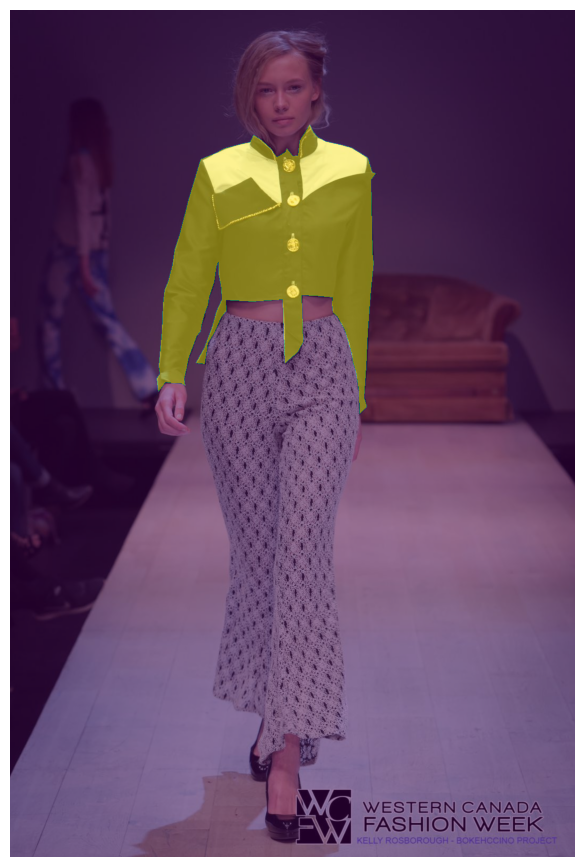

In [67]:
# jacket
plot_individual_segment(masks[0], image=image)


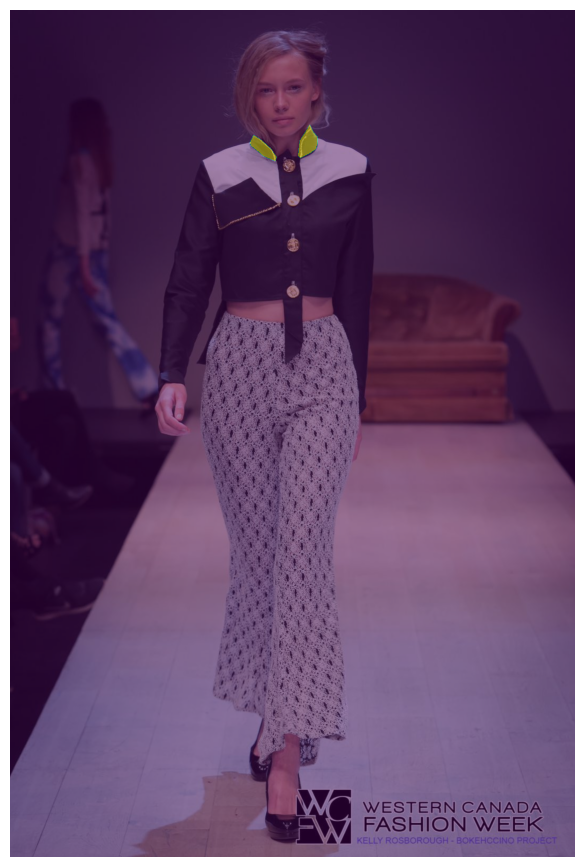

In [68]:
# collar
plot_individual_segment(masks[1], image=image)

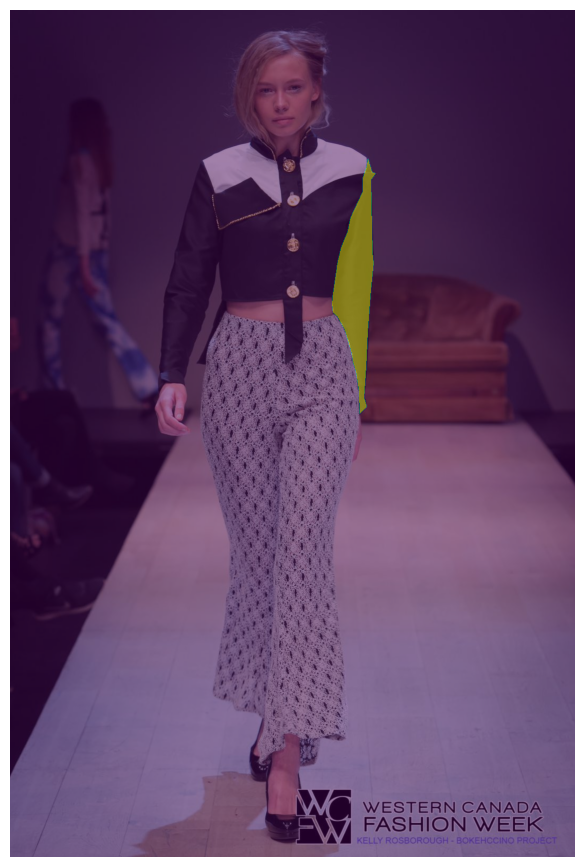

In [69]:
# sleeve
plot_individual_segment(masks[2], image=image)

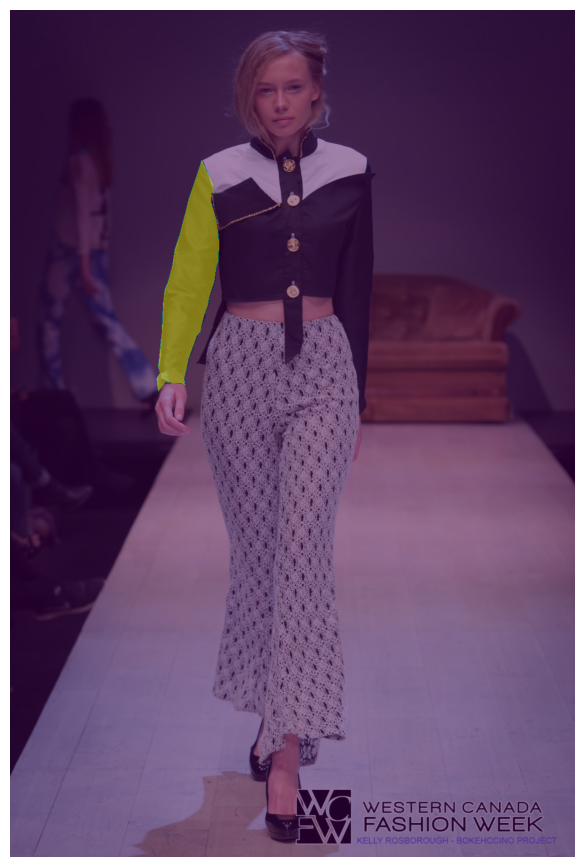

In [70]:
# sleeve
plot_individual_segment(masks[3], image=image)

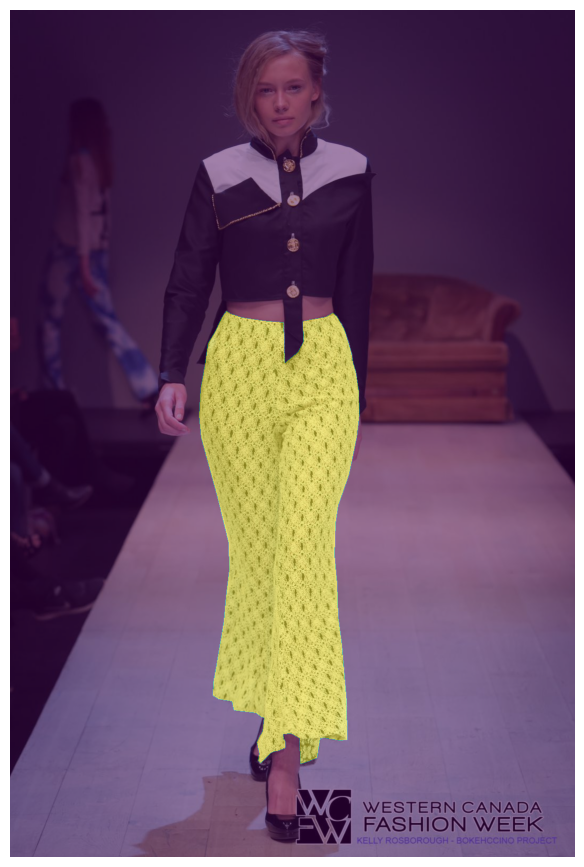

In [71]:
# pants
plot_individual_segment(masks[4], image=image)

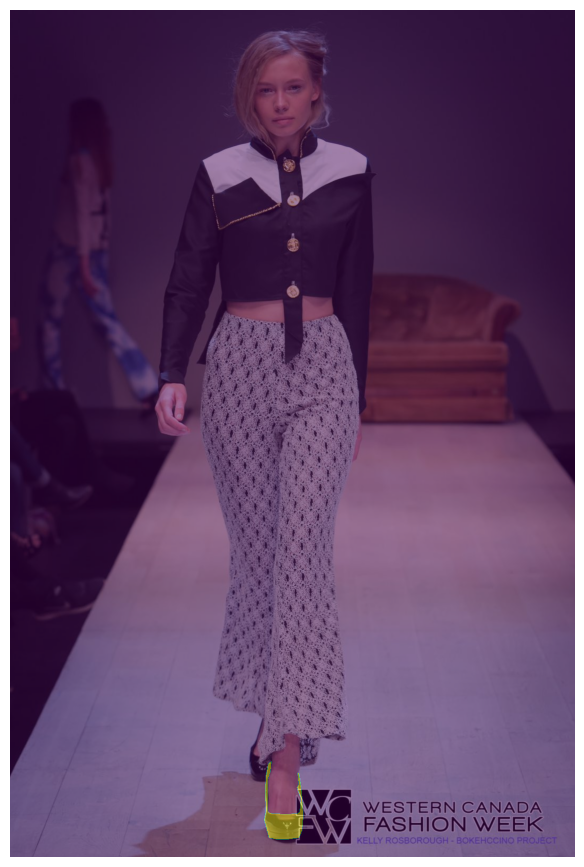

In [72]:
# shoe
plot_individual_segment(masks[5], image=image)

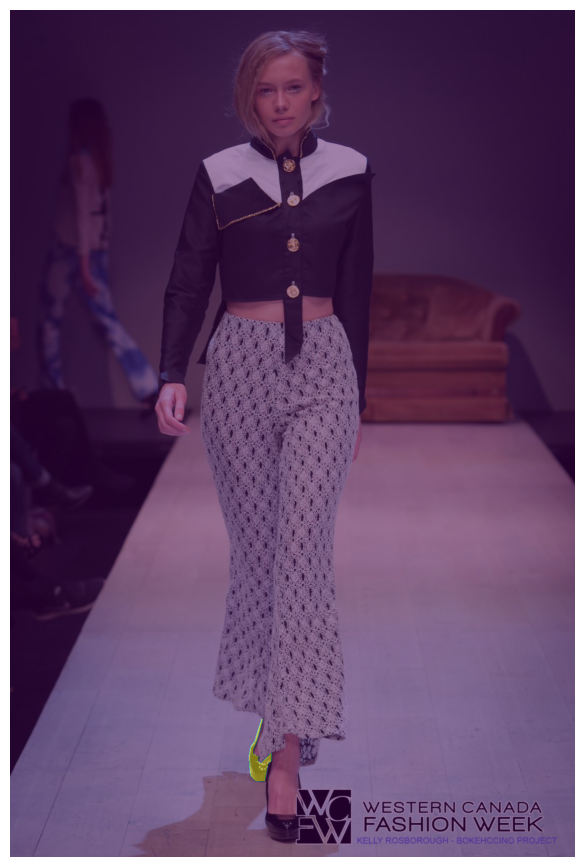

In [73]:
# shoe
plot_individual_segment(masks[6], image=image)

# Data Preprocessing

**Categories to Drop**
The following categories were identified as candidates for removal from the dataset:

- Accessories: tie, glove, sock, umbrella
- Clothing Elements: lapel, collar, hood, epaulette, sleeve, pocket, neckline
- Decorations: buckle, zipper, applique, bead, bow, flower, fringe, ribbon, tassel, rivet, ruffle, sequin

These categories may not be as relevant to the specific focus of the project or may introduce noise or complexity into the analysis. It's recommended to carefully consider the impact of removing these categories on the overall goals and objectives of the project.

In [8]:
drop_those_classes = [16,17,22,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45] # id's of unneeded classes

# Dropping unwanted categories
dataset = dataset[~dataset['ClassId'].isin(drop_those_classes)]
dataset = dataset.reset_index().drop(columns=['index'])

print(f'The shape of the original data: {dataset.shape}')
print(f'The shape of the new data after deleting unwanted categories: {dataset.shape}')
print(f'Number of images in training dataset {dataset['ImageId'].nunique()}')

dataset.head()

The shape of the original data: (157501, 6)
The shape of the new data after deleting unwanted categories: (157501, 6)
Number of images in training dataset 45622


,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,6,"115,136,143,154,230,295,316,317"
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,0,"115,136,142,146,225,295,316,317"
2,00000663ed1ff0c4e0132b9b9ac53f6e,4566382 8 4571592 25 4576803 41 4582013 58 458...,5214,3676,4,"17,115,136,145,149,225,295,311,317"
3,0000fe7c9191fba733c8a69cfaf962b7,1343707 9 1346138 27 1348569 44 1351000 62 135...,2448,2448,1,"0,115,145,146,295,316,317"
4,0002ec21ddb8477e98b2cbb87ea2e269,2287509 4 2290504 12 2290588 26 2293501 18 229...,3000,1997,10,"102,128,142,150,229,295,301,318"


displaying count of remaining categories 

In [9]:
# count remained values from each category 
remained_categories = pd.DataFrame(dataset['ClassId'].value_counts()) 

# reset index to free the id column from being an index
remained_categories = remained_categories.reset_index() 

# merging 2 df to see name of each remained category
remained_categories = remained_categories.merge(categories_df, left_on= 'ClassId',right_on='id', how='left') 

# filtering only needed columns
remained_categories = remained_categories[['id', 'name', 'count']] 

# set id as index 
remained_categories = remained_categories.set_index('id') 

remained_categories

,name,count
id,,
23,shoe,46374
10,dress,18739
1,"top, t-shirt, sweatshirt",16548
6,pants,12414
4,jacket,7833
24,"bag, wallet",7217
19,belt,6851
0,"shirt, blouse",6161
8,skirt,5046


In [10]:
# Create a mapping dictionary to remap the IDs
id_mapping = {
    old_id: int(new_id) for new_id, old_id in enumerate(remained_categories.index)
}

# Apply the mapping to the 'id' column in remained_categories
remained_categories = remained_categories.reset_index()
remained_categories['id'] = remained_categories['id'].map(id_mapping)
remained_categories = remained_categories.set_index('id')

# Apply the mapping to the 'ClassId' column in the dataset
dataset['ClassId'] = dataset['ClassId'].map(id_mapping)

remained_categories['name']

id
0                                        shoe
1                                       dress
2                    top, t-shirt, sweatshirt
3                                       pants
4                                      jacket
5                                 bag, wallet
6                                        belt
7                               shirt, blouse
8                                       skirt
9                                     glasses
10                          tights, stockings
11    headband, head covering, hair accessory
12                                      watch
13                                       coat
14                                     shorts
15                                        hat
16                                    sweater
17                                      scarf
18                                   cardigan
19                                   jumpsuit
20                                       vest
21                             

In [11]:
dataset.head()

,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,3,"115,136,143,154,230,295,316,317"
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,7,"115,136,142,146,225,295,316,317"
2,00000663ed1ff0c4e0132b9b9ac53f6e,4566382 8 4571592 25 4576803 41 4582013 58 458...,5214,3676,4,"17,115,136,145,149,225,295,311,317"
3,0000fe7c9191fba733c8a69cfaf962b7,1343707 9 1346138 27 1348569 44 1351000 62 135...,2448,2448,2,"0,115,145,146,295,316,317"
4,0002ec21ddb8477e98b2cbb87ea2e269,2287509 4 2290504 12 2290588 26 2293501 18 229...,3000,1997,1,"102,128,142,150,229,295,301,318"


Checking if All images we have for training and testing are in JPG format

In [ ]:
# Check images format 

import os 
import imghdr

def check_jpg_format(dir_path) -> bool:
    """Check if all images in directory are in JPG format
    Args:
        directory_path: the path to directory containing the images 
    Return:
        True if all images are JPG, False otherwise
    """

    for filename in os.listdir(dir_path):
        if not filename.lower().endswith('.jpg'):
            continue
        file_path = os.path.join(dir_path, filename)
        if imghdr.what(file_path) != 'jpeg':
            raise "Image Type Error (Not JPG)"
        
    return True

# Train file
directory_path = r"C:\Users\sat\zaka ai\Cohort Project\Project\Data\train"
if check_jpg_format(directory_path):
  print("Train Folder: All images are in JPG format.")
else:
  print("Train Folder: Some images are not in JPG format.")

# Test file
directory_path = r"C:\Users\sat\zaka ai\Cohort Project\Project\Data\test"
if check_jpg_format(directory_path):
  print("Test Folder: All images are in JPG format.")
else:
  print("Test Folder: Some images are not in JPG format.")
        

**decode_encoded_pixels** is used to decode Run Length Encoded Pixels into Binary Mask

In [ ]:
# Decoding RLE mask format to a binary format

def decode_encoded_pixels(encoded_pixels, height, width):
    """
    Decode a list of RLE-encoded pixel strings into bianry masks.

    Parameters:
    - encoded_pixels: RLE-encoded pixel strings.
    - height: Height of the images.
    - width: Width of the images.

    Returns:
    - mask: binary masks for segment.
    """

    # Initialize empty mask
    mask = np.zeros((height, width), dtype=np.uint8).reshape(-1)

    # Iterate over encoded pixels and create mask
    splitted_pixels = list(map(int, encoded_pixels.split()))
    pixel_starts = splitted_pixels[::2]
    run_lengths = splitted_pixels[1::2]
        
    assert max(pixel_starts) < mask.shape[0], "Pixel start index exceeds mask size"
    
    # map consecutive values stored in rle and set them to 1 in the binary mask
    for pixel_start, run_length in zip(pixel_starts, run_lengths):
        pixel_start = int(pixel_start) - 1
        run_length = int(run_length)
        mask[pixel_start:pixel_start + run_length] = 255  # Assign the mask value, e.g., 255 for the segment

    mask = mask.reshape((height, width), order='F')
    
    # Threshold the mask to ensure binary values (0 or 1)
    _, mask = cv2.threshold(mask, 127, 1, cv2.THRESH_BINARY)
    
    return mask

In [ ]:
# defining a bounding box for each mask
def get_bbox(mask):
  """
  Calculates the bounding box of a binary mask.
  Args:
    mask: A 2D binary mask.
  Returns:
    A tuple (x1, y1, x2, y2) representing the bounding box coordinates.
  """

  # Find the indices of non-zero pixels
  rows, cols = np.where(mask)

  # If there are no non-zero pixels, return an empty bounding box
  if len(rows) == 0:
    return None

  # Find the minimum and maximum indices
  x1 = min(cols)
  y1 = min(rows)
  x2 = max(cols)
  y2 = max(rows)
  return [x1, y1, x2, y2]

In [ ]:
def process_dataset(dataset):
  """
  Processes a dataset containing encoded pixels, height, width, class IDs, and image IDs.
  Args:
      dataset: A pandas DataFrame containing the following columns:
          - EncodedPixels (str): RLE-encoded pixel strings for segmentation.
          - Height (int): Height of the corresponding image.
          - Width (int): Width of the corresponding image.
          - ClassId (int): Class ID for the segmentation.
          - ImageId (str): Unique identifier for the image (if available).
  Returns:
      A modified DataFrame with the following additional columns:
          - BBox (list): List of bounding boxes for each segment in the corresponding row.
          - Binary_Mask_Path (list): List of paths to the saved binary masks for each segment in the corresponding row.
          - Polygon (list): masks in polygon format.
          - NoramlizedPolygons (list): normalized Polygons
  """

  # Create new columns to store the results
  dataset['BBox'] = None
  dataset['Binary_Mask_Path'] = None
  dataset['Polygons'] = None
  dataset['NoramlizedPolygons'] = None


  # Iterate over each row in the dataset
  for index, row in dataset.iterrows():
    
    # Extract height and width from the row
    Height = int(row['Height'])
    Width = int(row['Width'])
    Enc_pixels = row['EncodedPixels']

    # Encode RLE masks to Binary mask
    mask = decode_encoded_pixels(Enc_pixels, Height, Width)

    # Get bounding box of each mask
    bbox = get_bbox(mask)

    # Check if image id is in the columns section or index to use it in saving path
    if 'ImageId' in row:
      image_id = row['ImageId']
    else:
      image_id = index
    
    # Create path to save binary mask 
    path = f'C:/Users/sat/zaka ai/Cohort Project/Project/Data/Binary_Mask/{image_id}_{class_id}_{index}_binaryMask.png'

    # Save the binary mask
    cv2.imwrite(path, mask)

    # transform mask into polygon 
    polygon = Mask(mask).polygons()[0] 
    polys = polygon

    # Normalize x and y coordinates on width and height values
    normalized_polygon = [(polys[i] / Width if i % 2 == 0 else polys[i] / Height) for i in range(len(polys))]
    
    dataset.at[index, 'Polygons'] = polygon # YOLOv8
    dataset.at[index, 'NoramlizedPolygons'] = normalized_polygon # YOLOv8
    dataset.at[index, 'BBox'] = bbox # SAM
    dataset.at[index, 'Binary_Mask_Path'] = path # SAM
    
  return dataset

In [12]:
processed_dataset = process_dataset(dataset)
processed_dataset

,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds,BBox,Binary_Mask_Path
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,3,"115,136,143,154,230,295,316,317","[1163, 3923, 2839, 5212]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,7,"115,136,142,146,225,295,316,317","[1212, 1371, 2394, 3978]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
2,00000663ed1ff0c4e0132b9b9ac53f6e,4566382 8 4571592 25 4576803 41 4582013 58 458...,5214,3676,4,"17,115,136,145,149,225,295,311,317","[875, 1437, 3309, 4871]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
3,0000fe7c9191fba733c8a69cfaf962b7,1343707 9 1346138 27 1348569 44 1351000 62 135...,2448,2448,2,"0,115,145,146,295,316,317","[548, 405, 1946, 2263]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
4,0002ec21ddb8477e98b2cbb87ea2e269,2287509 4 2290504 12 2290588 26 2293501 18 229...,3000,1997,1,"102,128,142,150,229,295,301,318","[762, 719, 1262, 1967]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
...,...,...,...,...,...,...,...,...
157496,fffe20b555b98c3c1f26c8dfff275cbc,3800472 4 3803465 12 3806458 20 3809451 29 381...,3000,2001,0,NaN,"[1266, 2420, 1511, 2664]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
157497,fffe20b555b98c3c1f26c8dfff275cbc,2915555 2 2918553 4 2921550 7 2924547 9 292754...,3000,2001,0,NaN,"[971, 2440, 1115, 2656]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
157498,fffe20b555b98c3c1f26c8dfff275cbc,2611656 2 2614657 4 2617657 8 2620658 11 26236...,3000,2001,3,"36,115,128,136,142,154,230,295,298,317","[870, 1449, 1413, 2478]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...
157499,fffe20b555b98c3c1f26c8dfff275cbc,2446541 2 2449539 5 2452536 10 2455534 14 2458...,3000,2001,7,"115,136,142,146,225,295,316,322","[815, 640, 1128, 1576]",C:/Users/sat/zaka ai/Cohort Project/Project/Da...


In [13]:
# create df that contain image id and its corresponding height and weight
size_df = processed_dataset.groupby('ImageId')[['Height', 'Width']].mean()
# create df that contain only image id and all of its classes, bbox and binary masks paths in 1 row
processed_dataset = processed_dataset.groupby('ImageId')[['ClassId','BBox','Binary_Mask_Path','Polygons','NoramlizedPolygons']].agg(lambda x: list(x))
# merge 2 df
processed_dataset = processed_dataset.join(size_df, on = 'ImageId')

processed_dataset = processed_dataset.reset_index()
print("Total images: ", len(processed_dataset))
processed_dataset.head()

Total images:  45622


,ImageId,ClassId,BBox,Binary_Mask_Path,Height,Width
0,00000663ed1ff0c4e0132b9b9ac53f6e,"[3, 7, 4]","[[1163, 3923, 2839, 5212], [1212, 1371, 2394, ...",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,5214.0,3676.0
1,0000fe7c9191fba733c8a69cfaf962b7,[2],"[[548, 405, 1946, 2263]]",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,2448.0,2448.0
2,0002ec21ddb8477e98b2cbb87ea2e269,"[1, 0, 0]","[[762, 719, 1262, 1967], [1025, 2512, 1179, 28...",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,3000.0,1997.0
3,0002f5a0ebc162ecfb73e2c91e3b8f62,"[1, 11]","[[0, 112, 398, 565], [235, 2, 271, 17]]",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,567.0,400.0
4,0004467156e47b0eb6de4aa6479cbd15,"[1, 11]","[[176, 188, 447, 712], [256, 86, 297, 113]]",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,750.0,500.0


Now, it's the time to create a fodler that contain YOLOv8 Annotations with has the following structure:

```l
data
├── images
│   ├── train
│   │   ├── img1.jpg
│   │   ├── img2.jpg
│   │   └── ...
│   ├── val
│   │   ├── img1.jpg
│   │   ├── img2.jpg
│   │   └── ...
│   └── test
│       ├── img1.jpg
│       ├── img2.jpg
│       └── ...
├── labels
│   ├── train
│   │   ├── img1.txt
│   │   ├── img2.txt
│   │   └── ...
│   ├── val
│   │   ├── img1.txt
│   │   ├── img2.txt
│   │   └── ...
│   └── test
│       ├── img1.txt
│       ├── img2.txt
│       └── ...


In [ ]:
output_dir = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8 Annotation'
os.makedirs(output_dir, exist_ok= True)

# Create yolov8 foramt for each image
for idx, row in process_dataset.iterrows(): 
    image_id = row['ImageId']
    class_ids = row['ClassId']
    polygons = row['NormalizedPolygons']
    
    # Create a .txt file for each image
    with open(os.path.join(output_dir, f'{image_id}.txt'), 'w') as f:
        for class_id, polygon in zip(class_ids, polygons):
            # Write class_id followed by normalized polygon points
            polygon_str = ' '.join(map(str, polygon))
            f.write(f"{class_id} {polygon_str}\n")

print(f"YOLOv8 annotation files saved to {output_dir}.")

# Representitive sample 
The following code cells aim to create a representative sample of images from the dataset, focusing on categories that might be underrepresented. This helps to address class imbalance and ensures that the model has sufficient data to learn from each category.
we want to take representative sample because training the model with such huge dataset of more than 45k will take a lot of time and resources and it may cause confusion for the model

The following code cells aim to create a representative sample of images from the dataset, focusing on categories that might be underrepresented. This helps to address class imbalance and ensures that the model has sufficient data to learn from each category.
we want to take representative sample because training the model in such huge dataset of more than 45k will take a lot of time and resources and it may cause confusion for the model

In [15]:
# Create a dictionary mapping IDs to class names
class_names = {
    0: 'shoe',
    1: 'dress',
    2: 'top, t-shirt, sweatshirt',
    3: 'pants',
    4: 'jacket',
    5: 'bag, wallet',
    6: 'belt',
    7: 'shirt, blouse',
    8: 'skirt',
    9: 'glasses',
    10: 'tights, stockings',
    11: 'headband, head covering, hair accessory',
    12: 'watch',
    13: 'coat',
    14: 'shorts',
    15: 'hat',
    16: 'sweater',
    17: 'scarf',
    18: 'cardigan',
    19: 'jumpsuit',
    20: 'vest',
    21: 'cape',
    22: 'leg warmer'
}

# Create a dataframe for each class
shoe_df = dataset[dataset['ClassId'] == 0] # Use the class ID (0) instead of the class name ('shoe')
dress_df = dataset[dataset['ClassId'] == 1]
top_df = dataset[dataset['ClassId'] == 2]
pants_df = dataset[dataset['ClassId'] == 3]
jacket_df = dataset[dataset['ClassId'] == 4]
bag_df = dataset[dataset['ClassId'] == 5]
belt_df = dataset[dataset['ClassId'] == 6]
shirt_df = dataset[dataset['ClassId'] == 7]
skirt_df = dataset[dataset['ClassId'] == 8]
glasses_df = dataset[dataset['ClassId'] == 9]
tights_df = dataset[dataset['ClassId'] == 10]
headband_df = dataset[dataset['ClassId'] == 11]
watch_df = dataset[dataset['ClassId'] == 12]
coat_df = dataset[dataset['ClassId'] == 13]
shorts_df = dataset[dataset['ClassId'] == 14]
hat_df = dataset[dataset['ClassId'] == 15]
sweater_df = dataset[dataset['ClassId'] == 16]
scarf_df = dataset[dataset['ClassId'] == 17]
cardigan_df = dataset[dataset['ClassId'] == 18]
jumpsuit_df = dataset[dataset['ClassId'] == 19]
vest_df = dataset[dataset['ClassId'] == 20]
cape_df = dataset[dataset['ClassId'] == 21]
leg_warmer_df = dataset[dataset['ClassId'] == 22]

In [16]:
# Take a sample of 110 image IDs from each category dataset
jacket_sample = jacket_df.sample(n=700, random_state=42)['ImageId'].tolist()
bag_sample = bag_df.sample(n=700, random_state=42)['ImageId'].tolist()
belt_sample = belt_df.sample(n=700, random_state=42)['ImageId'].tolist()
shirt_blouse_sample = shirt_df.sample(n=700, random_state=42)['ImageId'].tolist()
skirt_sample = skirt_df.sample(n=700, random_state=42)['ImageId'].tolist()
glasses_sample = glasses_df.sample(n=700, random_state=42)['ImageId'].tolist()
tights_stockings_sample = tights_df.sample(n=700, random_state=42)['ImageId'].tolist()
headband_head_covering_sample = headband_df.sample(n=700, random_state=42)['ImageId'].tolist()
leg_warmer_sample = leg_warmer_df.sample(n=112, random_state=42)['ImageId'].tolist()
cape_sample = cape_df.sample(n=152, random_state=42)['ImageId'].tolist()
vest_sample = vest_df.sample(n=700, random_state=42)['ImageId'].tolist()
jumpsuit_sample = jumpsuit_df.sample(n=700, random_state=42)['ImageId'].tolist()
cardigan_sample = cardigan_df.sample(n=700, random_state=42)['ImageId'].tolist()
watch_sample = watch_df.sample(n=700, random_state=42)['ImageId'].tolist()
coat_sample = coat_df.sample(n=700, random_state=42)['ImageId'].tolist()
shorts_sample = shorts_df.sample(n=700, random_state=42)['ImageId'].tolist()
hat_sample = hat_df.sample(n=700, random_state=42)['ImageId'].tolist()
sweater_sample = sweater_df.sample(n=700, random_state=42)['ImageId'].tolist()
scarf_sample = scarf_df.sample(n=700, random_state=42)['ImageId'].tolist()

# Combine all the samples into a single list
combined_samples = (jacket_sample + bag_sample + belt_sample + shirt_blouse_sample + skirt_sample +
                    glasses_sample + tights_stockings_sample + headband_head_covering_sample +
                    leg_warmer_sample + cape_sample + vest_sample + jumpsuit_sample + cardigan_sample +
                    watch_sample + coat_sample + shorts_sample + hat_sample + sweater_sample + scarf_sample)

# Get the unique image IDs
unique_image_ids = list(set(combined_samples))

# Print the number of unique image IDs
print(f"Number of unique image IDs: {len(unique_image_ids)}")


Number of unique image IDs: 10410


In [17]:
# Filter the dataset to include only images in the unique_image_ids list
df = dataset[dataset['ImageId'].isin(unique_image_ids)]
df = df.reset_index(drop=True)
print(f'dataset shape: {df.shape[0]} row and {df.shape[1]} columns')


dataset shape: 48130 row and 6 columns


In [18]:
(df['ClassId'].value_counts())

ClassId
0     11919
2      3980
3      3355
5      2644
4      2421
6      2390
10     2252
1      2247
7      2142
9      2066
8      1695
12     1484
11     1399
13     1357
15     1345
14     1187
17      915
16      843
18      789
19      730
20      706
21      152
22      112
Name: count, dtype: int64

as we can notice even without including shoes category it s still dominating due to its behavior to exist in most of pics

In [19]:
representative_df = processed_dataset[processed_dataset['ImageId'].isin(unique_image_ids)]
representative_df = representative_df.reset_index(drop=True)
print(f'Filtered dataset shape: {representative_df.shape}')
representative_df.head()

Filtered dataset shape: (10410, 6)


,ImageId,ClassId,BBox,Binary_Mask_Path,Height,Width
0,0002f5a0ebc162ecfb73e2c91e3b8f62,"[1, 11]","[[0, 112, 398, 565], [235, 2, 271, 17]]",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,567.0,400.0
1,000aac3870ea7c59ca0333ffa5327323,"[1, 18]","[[2242, 1211, 3337, 3350], [2155, 1183, 3301, ...",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,4000.0,6000.0
2,001657dc6f979869ebf38ea741e90675,"[2, 12]","[[41, 458, 1094, 1741], [829, 1591, 953, 1681]]",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,1998.0,1141.0
3,003a6ca3eaa7886da61ed2de2c5e8d27,"[0, 0, 3, 13, 16]","[[1894, 2206, 2170, 2653], [1547, 2303, 1912, ...",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,2733.0,3630.0
4,003c831a9e84ee589d67c4d91786f525,"[16, 3, 0, 0]","[[80, 103, 234, 311], [110, 301, 207, 513], [1...",[C:/Users/sat/zaka ai/Cohort Project/Project/D...,600.0,371.0


In [20]:
# Split the data into train, test, and validation sets
from sklearn.model_selection import train_test_split
train_df, temp_df = train_test_split(representative_df, test_size=0.2, random_state=42)
val_df, test_df = train_test_split(temp_df, test_size=0.4, random_state=42)

print(f"Train dataset shape: {train_df.shape}")
print(f"Validation dataset shape: {val_df.shape}")
print(f"Test dataset shape: {test_df.shape}")


Train dataset shape: (8328, 6)
Validation dataset shape: (1249, 6)
Test dataset shape: (833, 6)


In [30]:
train_df.to_json(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data huge\train_DF.json')
print('Train dataset saved')
val_df.to_json(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data huge\val_DF.json')
print('Validation dataset saved')
test_df.to_json(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data huge\test_DF.json')
print('Test dataset saved')

Train dataset saved
Validation dataset saved
Test dataset saved


In [22]:
def create_yoloV8_dir(df: pd.DataFrame, img_path: str, annotation_path: str, saving_path: str, train: bool = True, test: bool = False):
  """
  Creates the necessary directory structure and copies images and annotations for YOLOv8 training or testing.

  Args:
      df (pd.DataFrame): The DataFrame containing image metadata.
      img_path (str): The path to the directory containing images.
      annotation_path (str): The path to the directory containing annotations.
      saving_path (str): The path to the directory where the YOLOv8 dataset will be saved.
      train (bool, optional): Whether to create the training dataset. Defaults to True.
      test (bool, optional): Whether to create the testing dataset. Defaults to False.
  """

  # Create the main saving directory if it doesn't exist
  if not os.path.exists(saving_path):
    os.makedirs(saving_path)

  # Determine the image and label directories based on the flags
  image_dir = 'images'
  label_dir = 'labels'
  if train:
    new_image_path = os.path.join(saving_path, image_dir, 'train')
    label_path = os.path.join(saving_path, label_dir, 'train')
  elif test:
    new_image_path = os.path.join(saving_path, image_dir, 'test')
    label_path = os.path.join(saving_path, label_dir, 'test')
  else:
    new_image_path = os.path.join(saving_path, image_dir, 'val')
    label_path = os.path.join(saving_path, label_dir, 'val')

  # Create the image and label subdirectories if they don't exist
  os.makedirs(new_image_path, exist_ok=True)
  os.makedirs(label_path, exist_ok=True)

  # Iterate through the DataFrame and copy images and annotations
  for index, row in df.iterrows():
    image_id = row['ImageId']

    # Check if the image and annotation already exist
    image_exists = os.path.exists(os.path.join(new_image_path, f'{image_id}.jpg'))
    annotation_exists = os.path.exists(os.path.join(label_path, f'{image_id}.txt'))

    # Copy the image if it doesn't exist
    if not image_exists:
      shutil.copy(os.path.join(img_path, f'{image_id}.jpg'), os.path.join(new_image_path, f'{image_id}.jpg'))

    # Copy the annotation if it doesn't exist
    if not annotation_exists:
      shutil.copy(os.path.join(annotation_path, f'{image_id}.txt'), os.path.join(label_path, f'{image_id}.txt'))

  # Print a message indicating the completion of data transformation
  if train:
    print("Training data transformation is Done")
  elif test:
    print("Testing data transformation is Done")
  else:
    print("Validating data transformation is Done")

In [24]:
# train data 
create_yoloV8_dir(train_df, r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train',
                  r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8 Annotation',
                    r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data huge',
                    train = True, test= False)

# test data
create_yoloV8_dir(test_df, r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train',
                  r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8 Annotation',
                    r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data huge',
                    train = False, test= True)

# val data 
create_yoloV8_dir(val_df, r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\train',
                  r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8 Annotation',
                    r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data huge',
                    train = False, test= False)

Transformation is Done


# Models


## YOLOv8

First to ensure no errors in training loop. we removed any corrupted annotation that contain less than or = to 5 elements in txt files 
```
correct label: class_id x1y1 x2y2 ... xnyn(more than 5 elements)
corrupt label: class_id x1y1 x2y2 (5 elements)  


### Prepare data 

In [ ]:
import os

def find_corrupt_images(annotation_folder: str) -> list[str]:
  """
  Finds corrupt images in a YOLOv8 annotation folder based on the number of elements in each annotation line(if labels contain less than or = 5 means that s not a segmentation folder).

  Args:
      annotation_folder (str): The path to the annotation folder.

  Returns:
      list[str]: A list of image filenames that are considered corrupt.
  """

  corrupt_images_filenames = []

  for annotation_file in os.listdir(annotation_folder):
    if annotation_file.endswith('.txt'):
      with open(os.path.join(annotation_folder, annotation_file), 'r') as f:
        lines = f.readlines()

      for line in lines:
        elements = line.strip().split()

        # Check if the annotation has the expected number of elements for YOLOv8 object detection
        if len(elements) <= 5:
          corrupt_images_filenames.append(annotation_file.replace('.txt', ''))

  return corrupt_images_filenames

#### Train data

find corrupted files in train data

In [ ]:
# Define the path to train YOLOv8 annotations folder
annotation_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\train'

# Find all corrupted annotations 
Corrupt_image_filenames = find_corrupt_images(annotation_folder)

print("Number of Corrupted images in train data:", len(Corrupt_image_filenames))

Delete corrupted files in train data

In [ ]:
annotation_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\train'
image_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\images\train'

for id in Corrupt_image_filenames:

    img_path = os.path.join(image_folder,f'{id}.jpg')
    ann_path = os.path.join(annotation_folder,f'{id}.txt')

    # delete images with bbox in labels
    if os.path.exists(img_path):
        os.remove(img_path)
        print(f"Deleted image file: {img_path}")
    else:
        print(f"Image file not found: {img_path}")

    # Delete the corresponding label file
    if os.path.exists(ann_path):
        os.remove(ann_path)
        print(f"Deleted label file: {ann_path}")
    else:
        print(f"Label file not found: {ann_path}")

    

#### Test data

find corrupted files in test data

In [ ]:
# Define the path to train YOLOv8 annotations folder
annotation_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\test'

# Find all corrupted annotations 
Corrupt_image_filenames = find_corrupt_images(annotation_folder)

print("Number of Corrupted images in train data:", len(Corrupt_image_filenames))

delete corrupted annotations in test data

In [ ]:
annotation_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\test'
image_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\images\test'

for id in Corrupt_image_filenames:

    img_path = os.path.join(image_folder,f'{id}.jpg')
    ann_path = os.path.join(annotation_folder,f'{id}.txt')

    # delete images with bbox in labels
    if os.path.exists(img_path):
        os.remove(img_path)
        print(f"Deleted image file: {img_path}")
    else:
        print(f"Image file not found: {img_path}")

    # Delete the corresponding label file
    if os.path.exists(ann_path):
        os.remove(ann_path)
        print(f"Deleted label file: {ann_path}")
    else:
        print(f"Label file not found: {ann_path}")

#### Validation Data

find corrupted annotations

In [ ]:
# Define the path to train YOLOv8 annotations folder
annotation_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\val'

# Find all corrupted annotations 
Corrupt_image_filenames = find_corrupt_images(annotation_folder)

print("Number of Corrupted images in train data:", len(Corrupt_image_filenames))

delete corrupted files

In [ ]:
annotation_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\val'
image_folder = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\images\val'

for id in Corrupt_image_filenames:

    img_path = os.path.join(image_folder,f'{id}.jpg')
    ann_path = os.path.join(annotation_folder,f'{id}.txt')

    # delete images with bbox in labels
    if os.path.exists(img_path):
        os.remove(img_path)
        print(f"Deleted image file: {img_path}")
    else:
        print(f"Image file not found: {img_path}")

    # Delete the corresponding label file
    if os.path.exists(ann_path):
        os.remove(ann_path)
        print(f"Deleted label file: {ann_path}")
    else:
        print(f"Label file not found: {ann_path}")

### Training 

In [1]:
from ultralytics import YOLO

# Load the model
model = YOLO(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\model\yolov8s-seg.pt')

# Now you can call the train method on the model object
result = model.train(data = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\config.yaml', # data
            epochs = 200, plots = True, device = 0, batch = 0.70, patience = 10, cos_lr = True, optimizer = 'SGD',   # different parameters 
            hsv_h = 0.3, hsv_s = 0.5, hsv_v = 0.4, degrees = +20, flipud = 0.5, fliplr = 0.5, bgr = 1, # augmentation 
            project = r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results', name = 'Final' ) # save dir 

Ultralytics YOLOv8.2.101  Python-3.12.1 torch-2.3.1+cu121 CUDA:0 (NVIDIA RTX A3000 Laptop GPU, 6144MiB)
engine\trainer: task=segment, mode=train, model=C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\model\yolov8s-seg.pt, data=C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\config.yaml, epochs=200, time=None, patience=10, batch=0.7, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results, name=Final, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augm

train: Scanning C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\train.cache... 3596 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3596/3596 [00:00<?, ?it/s]
val: Scanning C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\yolov8data large\data\labels\val.cache... 907 images, 0 backgrounds, 0 corrupt: 100%|██████████| 907/907 [00:00<?, ?it/s]


Plotting labels to C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\Final\labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 66 weight(decay=0.0), 77 weight(decay=0.0005), 76 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\Final
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/200      4.62G      1.188      2.532      3.215      1.269         25        640: 100%|██████████| 450/450 [11:16<00:00,  1.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:56<00:00,  1.00it/s]


                   all        907       4253      0.374      0.246      0.191      0.135      0.375      0.245      0.189      0.123

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/200      2.67G      1.055      2.149      2.204      1.149         42        640: 100%|██████████| 450/450 [07:24<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:42<00:00,  1.35it/s]


                   all        907       4253      0.333      0.246      0.212      0.151      0.336      0.245      0.209      0.136

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/200      2.63G       1.11      2.206      2.108       1.17         45        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:43<00:00,  1.31it/s]


                   all        907       4253      0.317      0.242      0.187      0.128      0.319      0.237       0.18      0.114

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/200      2.73G      1.193      2.335      2.142      1.218         25        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.225      0.273       0.21      0.144      0.243      0.262      0.208      0.133

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/200      2.67G      1.184      2.306      2.065      1.216         29        640: 100%|██████████| 450/450 [07:15<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.38it/s]


                   all        907       4253      0.289      0.276      0.224      0.151      0.347      0.265      0.219      0.139

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/200      2.72G      1.167      2.255      2.018      1.206         14        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:42<00:00,  1.33it/s]


                   all        907       4253      0.343      0.275      0.229      0.156      0.342      0.275      0.224       0.14

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/200      2.61G      1.146      2.213      1.955      1.193         20        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:42<00:00,  1.34it/s]


                   all        907       4253      0.362       0.29      0.261      0.183      0.361      0.287      0.256       0.17

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/200      2.67G      1.121       2.17      1.918      1.186         44        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:43<00:00,  1.32it/s]


                   all        907       4253      0.392      0.316      0.274      0.192      0.386      0.314      0.271      0.182

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/200      2.69G       1.12      2.151       1.89      1.179         37        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:42<00:00,  1.35it/s]


                   all        907       4253      0.428      0.301      0.259       0.18      0.435      0.301      0.256      0.167

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/200      2.71G      1.096      2.118      1.821      1.163         40        640: 100%|██████████| 450/450 [07:16<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.37it/s]


                   all        907       4253      0.382       0.34      0.278       0.19      0.382      0.336      0.272      0.178

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/200      2.62G      1.084      2.079      1.802      1.157         24        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.36it/s]


                   all        907       4253      0.386       0.33      0.283      0.203      0.386      0.327      0.279      0.189

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/200      2.67G      1.073      2.049      1.769      1.151         36        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:42<00:00,  1.35it/s]


                   all        907       4253      0.351      0.316      0.281      0.203      0.349      0.315      0.276      0.185

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/200      2.63G      1.066      2.037       1.77      1.148         37        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.36it/s]


                   all        907       4253      0.369      0.344      0.303      0.215      0.375      0.338      0.296      0.199

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/200      2.67G      1.053      2.007      1.722      1.135         41        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.38it/s]


                   all        907       4253      0.374      0.345      0.298      0.211      0.374      0.341      0.291      0.194

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/200      2.64G      1.042      1.978      1.707      1.136         34        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.37it/s]


                   all        907       4253      0.413      0.339      0.308      0.223      0.411       0.34      0.303      0.213

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/200      2.69G      1.045      1.976      1.698      1.136         43        640: 100%|██████████| 450/450 [07:16<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.38it/s]


                   all        907       4253      0.389       0.34      0.309       0.22      0.387      0.336      0.302      0.204

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/200      2.63G      1.036      1.961      1.685      1.127         20        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.37it/s]


                   all        907       4253        0.4      0.343      0.309       0.22      0.414      0.343      0.305      0.203

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/200      2.65G      1.028      1.951      1.667      1.122         32        640: 100%|██████████| 450/450 [07:16<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.36it/s]


                   all        907       4253      0.391      0.342      0.295      0.212      0.391      0.336       0.29      0.194

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/200      2.65G      1.018      1.917      1.628      1.116         33        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.38it/s]


                   all        907       4253      0.397      0.363       0.32      0.232      0.402      0.349      0.314      0.218

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/200      2.66G      1.004      1.914      1.616      1.112         20        640: 100%|██████████| 450/450 [07:25<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:43<00:00,  1.30it/s]


                   all        907       4253      0.366      0.367      0.309      0.223      0.361       0.36      0.302      0.205

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/200      2.64G      1.007      1.915      1.628      1.114         25        640: 100%|██████████| 450/450 [07:27<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:44<00:00,  1.28it/s]


                   all        907       4253      0.407      0.362      0.317      0.232      0.405      0.351      0.312      0.216

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/200       2.6G     0.9983      1.888      1.588      1.106         44        640: 100%|██████████| 450/450 [07:29<00:00,  1.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:44<00:00,  1.27it/s]


                   all        907       4253      0.422      0.358       0.34      0.246      0.475      0.346      0.333      0.232

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/200      2.65G     0.9995      1.903        1.6      1.107         36        640: 100%|██████████| 450/450 [07:31<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:44<00:00,  1.27it/s]


                   all        907       4253       0.43      0.347      0.323      0.233      0.435      0.345      0.318      0.217

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/200      2.63G     0.9845      1.854      1.564      1.096         30        640: 100%|██████████| 450/450 [07:34<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:48<00:00,  1.17it/s]


                   all        907       4253      0.469      0.352      0.332      0.244       0.47      0.341      0.326      0.229

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/200      2.69G     0.9713      1.833      1.537      1.094         41        640: 100%|██████████| 450/450 [07:53<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:56<00:00,  1.01it/s]


                   all        907       4253       0.42      0.365      0.336      0.246      0.429      0.356       0.33      0.228

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/200      2.68G      0.973      1.855      1.568      1.095         62        640: 100%|██████████| 450/450 [4:31:51<00:00, 36.25s/it]     
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.37it/s]


                   all        907       4253      0.395      0.391      0.339      0.249      0.405      0.372      0.331      0.231

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/200      2.68G     0.9694      1.831      1.535      1.093         45        640: 100%|██████████| 450/450 [07:25<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:42<00:00,  1.34it/s]


                   all        907       4253      0.452      0.368      0.346      0.254      0.457      0.366      0.342      0.238

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/200      2.64G     0.9688      1.822      1.535      1.091         48        640: 100%|██████████| 450/450 [07:21<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.438      0.378      0.349      0.255      0.443      0.371      0.343      0.239

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/200      2.69G     0.9497      1.796      1.508      1.078         53        640: 100%|██████████| 450/450 [07:20<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.39it/s]


                   all        907       4253      0.494      0.367      0.355      0.261      0.494      0.363      0.349      0.243

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/200      2.66G      0.949      1.782      1.496       1.08         38        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.434      0.385      0.346      0.256      0.429      0.384      0.339      0.238

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/200      2.68G     0.9413      1.771      1.475      1.072         22        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.441      0.391      0.346      0.255       0.44       0.39       0.34      0.237

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/200      2.63G      0.947      1.766      1.469      1.074         41        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.38it/s]


                   all        907       4253      0.423       0.36      0.341      0.253      0.431      0.348      0.335      0.235

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/200      2.63G     0.9399      1.745      1.465      1.072         33        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.39it/s]


                   all        907       4253      0.458      0.381       0.35      0.261      0.459      0.377      0.345      0.244

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/200      2.62G     0.9402      1.763      1.464      1.075         39        640: 100%|██████████| 450/450 [07:20<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.36it/s]


                   all        907       4253       0.42      0.382      0.339       0.25      0.424      0.378      0.333      0.232

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/200      2.63G     0.9291      1.722      1.431      1.067         44        640: 100%|██████████| 450/450 [07:21<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:42<00:00,  1.34it/s]


                   all        907       4253      0.437      0.384      0.363      0.271      0.437      0.384      0.358      0.254

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/200       2.7G     0.9318      1.743      1.443      1.069         24        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.488      0.371      0.358      0.268      0.485      0.373      0.351      0.252

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/200      2.66G     0.9319      1.744      1.416      1.067         40        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.37it/s]


                   all        907       4253      0.458       0.38      0.364      0.272      0.462      0.375      0.361      0.255

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/200      2.72G     0.9142      1.702      1.416      1.065         22        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.38it/s]


                   all        907       4253      0.434      0.381      0.351      0.258      0.436      0.378      0.344      0.243

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/200      2.61G      0.909      1.692      1.403      1.057         23        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.483       0.39      0.363      0.271      0.491      0.385      0.359      0.251

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/200      2.65G     0.9128        1.7      1.401       1.06         41        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.458      0.402      0.367      0.276      0.466      0.401      0.363      0.261

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/200      2.63G     0.9072      1.666      1.384      1.056         48        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.39it/s]


                   all        907       4253      0.433      0.402      0.373      0.279      0.465      0.376      0.366      0.261

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/200      2.61G     0.8958      1.674      1.372      1.053         34        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.459      0.374      0.352      0.263      0.463      0.368      0.346      0.246

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/200      2.73G     0.9021      1.677      1.365      1.051         50        640: 100%|██████████| 450/450 [07:20<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.474      0.389      0.377      0.285      0.478      0.384      0.371      0.267

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/200      2.76G     0.9023      1.674      1.362      1.053         38        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.447      0.388      0.364      0.273      0.444      0.382      0.358      0.254

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/200       2.7G     0.8981      1.667      1.363      1.053         31        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.454      0.395       0.36       0.27      0.458       0.39      0.356       0.25

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/200      2.62G     0.8866      1.648      1.351      1.047         36        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.481      0.393      0.372      0.278      0.477      0.389      0.365       0.26

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/200      2.66G     0.8917      1.664      1.344      1.048         21        640: 100%|██████████| 450/450 [07:20<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.506      0.376      0.371      0.278      0.503      0.373      0.365       0.26

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/200      2.67G     0.8824      1.642      1.339      1.041         55        640: 100%|██████████| 450/450 [07:20<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.39it/s]


                   all        907       4253      0.427      0.412      0.366       0.27      0.421      0.404      0.357      0.253

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/200      2.63G     0.8766      1.617       1.32       1.04         37        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.41it/s]


                   all        907       4253       0.47      0.406      0.379      0.286      0.472      0.404      0.374      0.268

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/200      2.62G     0.8792      1.626       1.31      1.039         40        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.446      0.401      0.364      0.271      0.437      0.399      0.357      0.251

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/200      2.64G     0.8718      1.596      1.296      1.037         37        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.39it/s]


                   all        907       4253      0.495      0.398      0.376       0.28        0.5      0.391      0.369      0.262

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/200       2.7G     0.8753      1.592        1.3      1.038         26        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.42it/s]


                   all        907       4253      0.459      0.403      0.379      0.284      0.463      0.399      0.371      0.264

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/200      2.67G      0.871      1.605      1.293      1.034         31        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.41it/s]


                   all        907       4253      0.473      0.414      0.381      0.286      0.473      0.411      0.377      0.268

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/200      2.68G     0.8651      1.592      1.281       1.03         28        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.483      0.404      0.384      0.289      0.479      0.401      0.376      0.269

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/200      2.68G     0.8602      1.589      1.265      1.028         21        640: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.40it/s]


                   all        907       4253      0.428      0.432      0.384      0.288       0.43      0.425      0.374      0.266

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/200      2.76G     0.8614      1.586      1.275       1.03         34        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.498      0.361      0.373       0.28      0.467       0.37      0.364      0.261

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/200      2.66G     0.8591      1.589      1.277       1.03         24        640: 100%|██████████| 450/450 [07:20<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:41<00:00,  1.39it/s]


                   all        907       4253      0.501      0.396      0.393      0.302      0.509      0.394      0.387      0.279

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/200      2.61G     0.8527      1.564      1.252      1.025         28        640: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.42it/s]


                   all        907       4253      0.441      0.422      0.386      0.294      0.466      0.402      0.383      0.273

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/200      2.67G     0.8546      1.566      1.251      1.022         28        640: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:40<00:00,  1.42it/s]


                   all        907       4253      0.451      0.415      0.381      0.291      0.463      0.389      0.372      0.268

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/200      2.65G     0.8527      1.557      1.217      1.022         44        640: 100%|██████████| 450/450 [07:00<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:37<00:00,  1.51it/s]


                   all        907       4253      0.462      0.405      0.379      0.287       0.46      0.398      0.371      0.267

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/200       2.7G     0.8465      1.541      1.233      1.021         12        640: 100%|██████████| 450/450 [06:48<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:38<00:00,  1.47it/s]


                   all        907       4253      0.488      0.407      0.387      0.292      0.473      0.416      0.382      0.273

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/200      2.61G     0.8448      1.541      1.224      1.018         34        640: 100%|██████████| 450/450 [06:48<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:38<00:00,  1.48it/s]


                   all        907       4253       0.46      0.405      0.376      0.282      0.458      0.404       0.37      0.263

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     63/200      2.64G      0.847      1.541      1.216      1.017         28        640: 100%|██████████| 450/450 [06:50<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:37<00:00,  1.51it/s]


                   all        907       4253      0.474      0.421      0.392      0.296      0.471      0.413      0.383      0.273

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     64/200      2.62G     0.8438      1.535      1.213      1.017         21        640: 100%|██████████| 450/450 [06:49<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:36<00:00,  1.56it/s]


                   all        907       4253      0.508      0.389       0.39      0.295      0.506      0.386      0.383      0.275

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     65/200      2.77G     0.8376      1.519      1.208      1.017         28        640: 100%|██████████| 450/450 [06:47<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:36<00:00,  1.55it/s]


                   all        907       4253      0.464      0.423      0.389      0.296      0.479      0.406      0.382      0.276

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     66/200      2.69G     0.8285      1.507       1.19      1.013         53        640: 100%|██████████| 450/450 [06:46<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:36<00:00,  1.54it/s]


                   all        907       4253      0.499       0.41      0.388      0.293      0.508        0.4      0.382      0.274

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     67/200      2.62G     0.8257       1.51      1.192       1.01         32        640: 100%|██████████| 450/450 [06:46<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:36<00:00,  1.56it/s]


                   all        907       4253      0.522      0.399      0.381      0.291      0.525      0.396      0.379      0.269
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 57, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

67 epochs completed in 13.407 hours.
Optimizer stripped from C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\Final\weights\last.pt, 23.8MB
Optimizer stripped from C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\Final\weights\best.pt, 23.8MB

Validating C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\Final\weights\best.pt...
Ultralytics YOLOv8.2.101  Python-3.12.1 torch-2.3.1+cu121 CUDA:0 (NVIDIA RTX A3000 Laptop GPU, 6144MiB)
YOLOv8s-seg summary (fused): 195 layers, 11,788,501 parameters, 0 gradients, 42.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:33<00:00,  1.69it/s]


                   all        907       4253      0.499      0.397      0.393      0.302      0.507      0.394      0.387       0.28
                  shoe        548       1071      0.732      0.828      0.835      0.628      0.729      0.816      0.816      0.513
                 dress        187        188      0.478      0.431      0.392      0.295        0.5      0.441      0.397      0.299
               t-shirt        337        346      0.423      0.283      0.258       0.19      0.435       0.28      0.259      0.185
                 pants        284        286      0.639      0.685      0.691      0.614      0.642      0.682       0.69      0.604
                jacket        198        201      0.483       0.47      0.439      0.373      0.478      0.458      0.419      0.349
                   bag        215        227        0.6      0.442      0.477      0.341      0.625      0.458      0.486      0.329
                  belt        203        209       0.41      0.293   

### Inference

#### First Model: trained on 1600 image and 160 for validation, 50 epoch and image size= 1024


0: 1024x704 2 shoes, 1 top, t-shirt, sweatshirt, 1 pants, 1 jacket, 1 bag, wallet, 84.8ms
Speed: 9.2ms preprocess, 84.8ms inference, 6.6ms postprocess per image at shape (1, 3, 1024, 704)


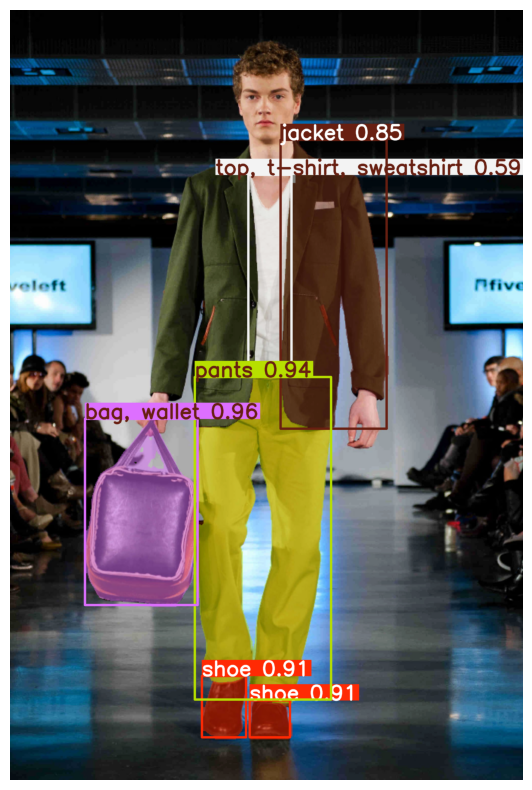

In [17]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/0e9775fcd1a3b1d95aed773e684b3f49.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\Downloads\last.pt')

prediction = model.predict(image, conf = 0.3, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)




0: 704x1024 2 shoes, 2 coats, 223.6ms
Speed: 11.1ms preprocess, 223.6ms inference, 20.0ms postprocess per image at shape (1, 3, 704, 1024)


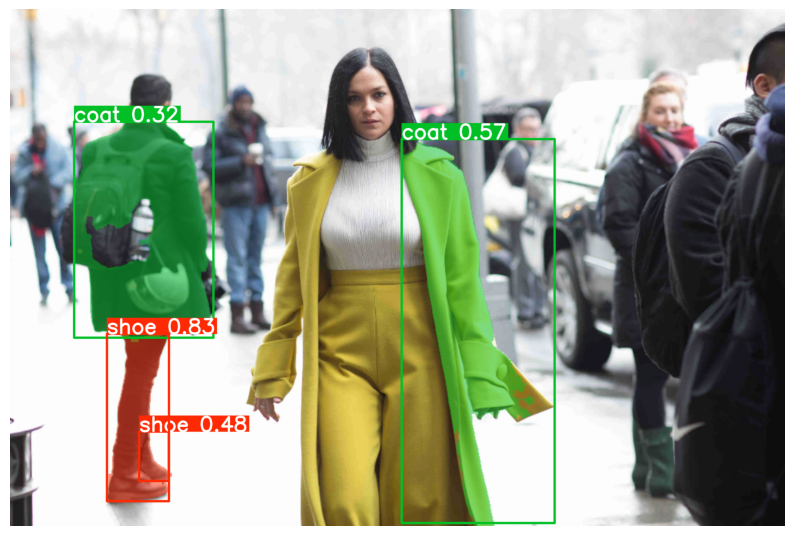

In [18]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/1ae9cdebd762234889e60f2c0d07a768.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\Downloads\last.pt')

prediction = model.predict(image, conf = 0.3, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)




0: 1024x704 1 shoe, 1 dress, 1 top, t-shirt, sweatshirt, 81.5ms
Speed: 10.3ms preprocess, 81.5ms inference, 5.6ms postprocess per image at shape (1, 3, 1024, 704)


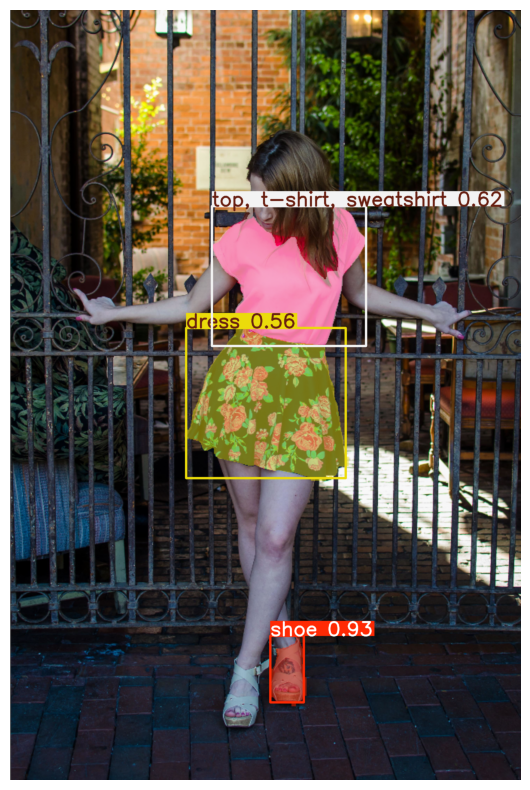

In [32]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/a9241e7a983feabc10d4c1e548e9b286.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\Downloads\last.pt')

prediction = model.predict(image, conf = 0.5, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)

#### Second: trained on 7.5 k image and  validated 1k images, imgsize = 1024 and epoch = 200


0: 1024x704 2 shoes, 2 t-shirts, 190.2ms
Speed: 9.8ms preprocess, 190.2ms inference, 4.1ms postprocess per image at shape (1, 3, 1024, 704)


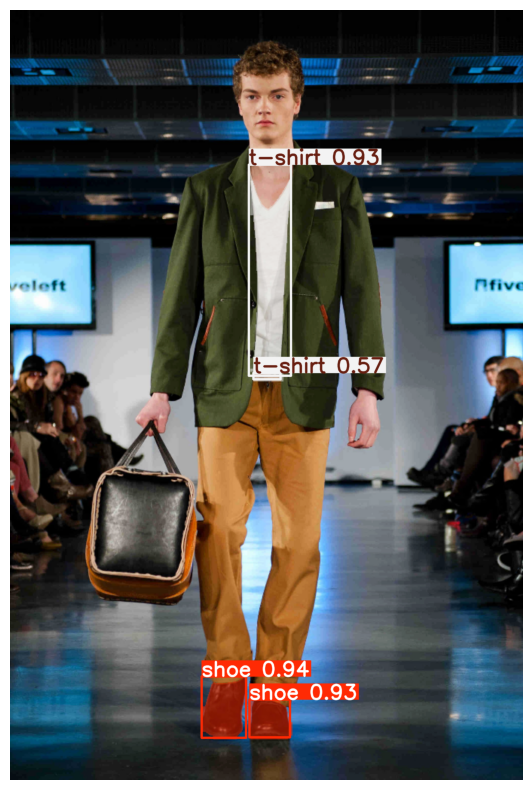

In [19]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/0e9775fcd1a3b1d95aed773e684b3f49.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\10000pic\weights\last.pt')

prediction = model.predict(image, conf = 0.3, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)




0: 704x1024 1 pants, 1 sweater, 202.3ms
Speed: 10.5ms preprocess, 202.3ms inference, 14.1ms postprocess per image at shape (1, 3, 704, 1024)


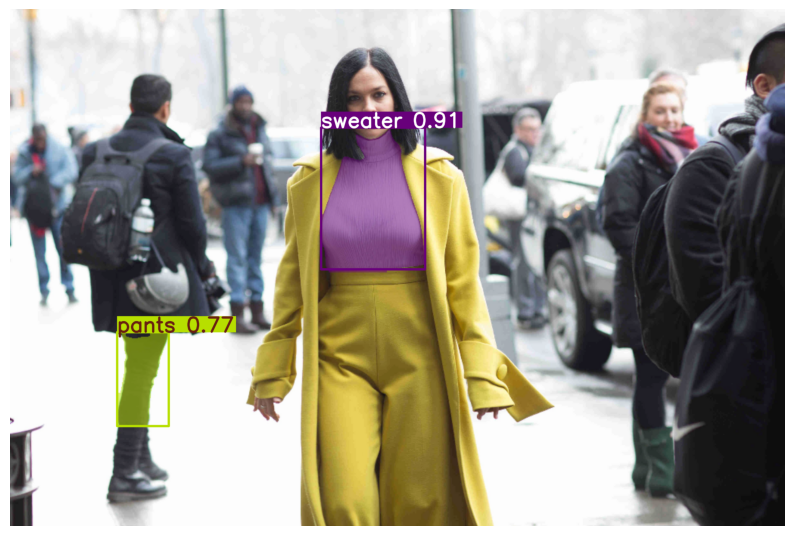

In [21]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/1ae9cdebd762234889e60f2c0d07a768.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\10000pic\weights\last.pt')

prediction = model.predict(image, conf = 0.3, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)




0: 1024x704 1 skirt, 177.0ms
Speed: 10.3ms preprocess, 177.0ms inference, 6.7ms postprocess per image at shape (1, 3, 1024, 704)


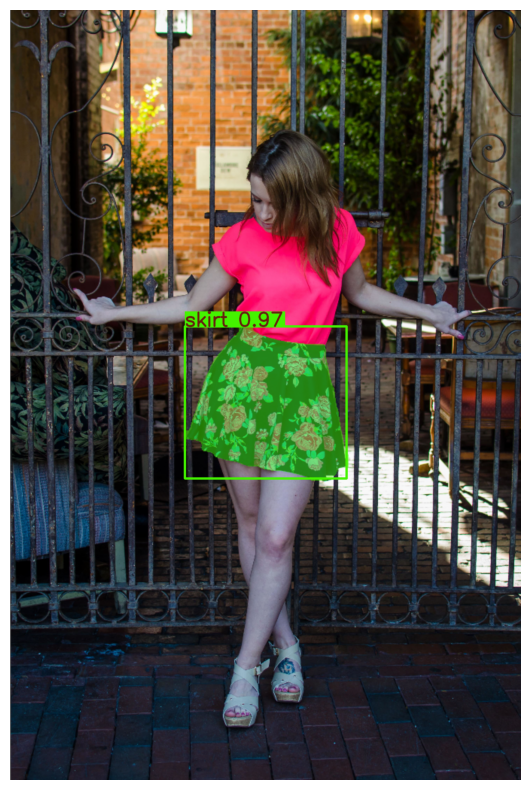

In [33]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/a9241e7a983feabc10d4c1e548e9b286.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\10000pic\weights\last.pt')

prediction = model.predict(image, conf = 0.3, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)

#### Last


0: 640x448 2 shoes, 1 t-shirt, 1 pants, 2 jackets, 1 bag, 208.1ms
Speed: 4.6ms preprocess, 208.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 448)


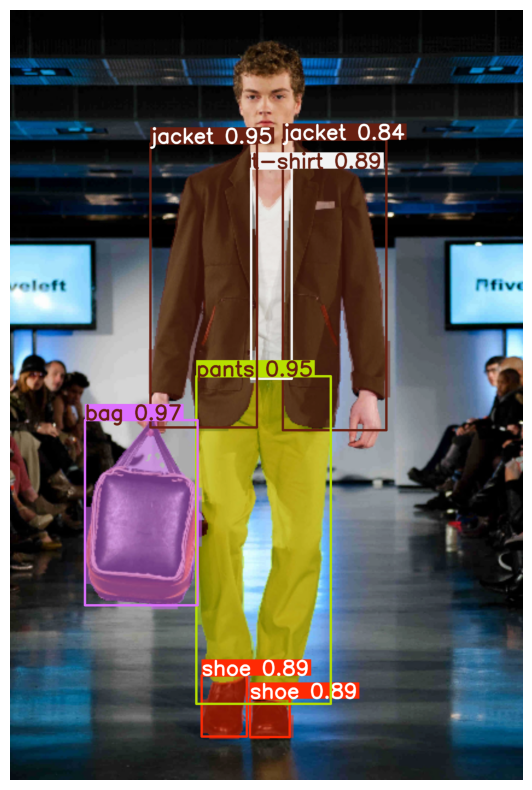

In [22]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/0e9775fcd1a3b1d95aed773e684b3f49.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\large\weights\last.pt')

prediction = model.predict(image, conf = 0.3, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)




0: 448x640 1 shoe, 1 t-shirt, 230.1ms
Speed: 4.0ms preprocess, 230.1ms inference, 6.1ms postprocess per image at shape (1, 3, 448, 640)


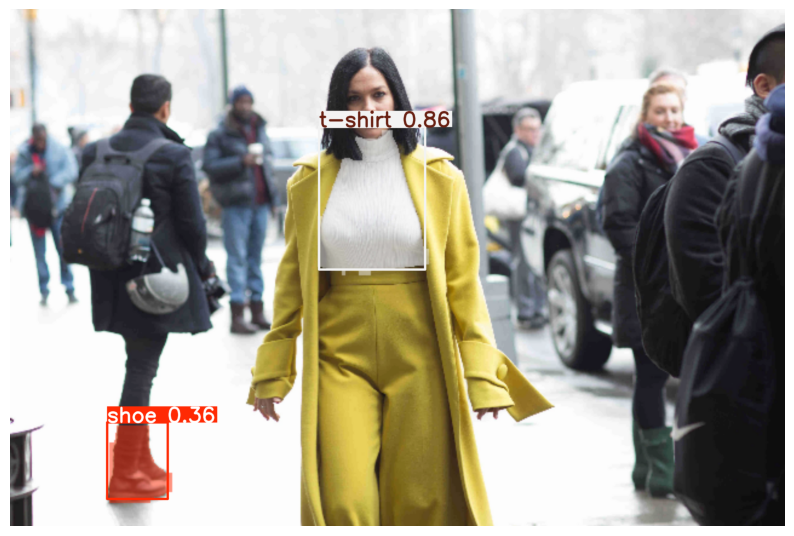

In [23]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/1ae9cdebd762234889e60f2c0d07a768.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\large\weights\last.pt')

prediction = model.predict(image, conf = 0.3, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)




0: 640x448 2 shoes, 1 t-shirt, 1 skirt, 29.3ms
Speed: 4.6ms preprocess, 29.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 448)


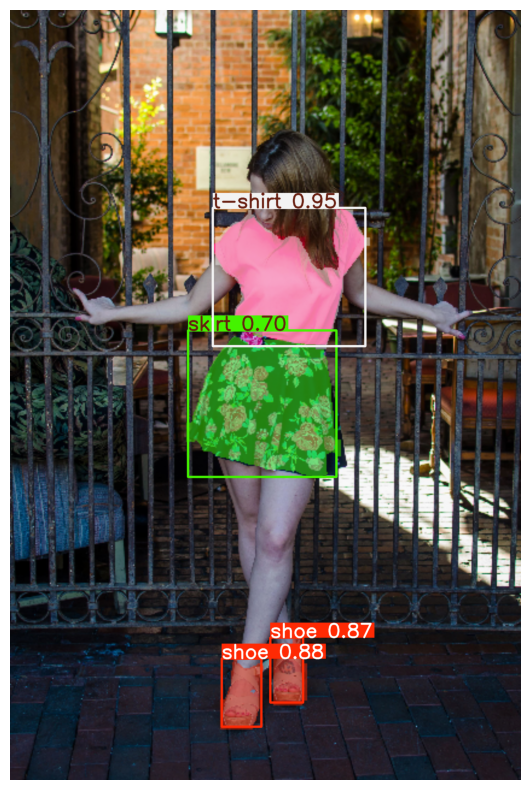

In [35]:
from ultralytics import YOLO

image = r'C:/Users/sat/zaka ai/Cohort Project/Project/Data/test/a9241e7a983feabc10d4c1e548e9b286.jpg'
image = cv2.imread(image)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

model = YOLO(r'C:\Users\sat\zaka ai\Cohort Project\Project\Data\YOLOv8\results\large\weights\last.pt')

prediction = model.predict(image, conf = 0.5, device = 0)
result_array = prediction[0].plot()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(result_array)

